In [ ]:
import os, cv2
import numpy as np
import pandas as pd
import random, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from PIL import Image

In [ ]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 69.8 MB/s eta 0:00:00


In [ ]:
#download data from kaggle and put in directory called deepglobe_dataset
!mkdir -p deepglobe_dataset
!kaggle datasets download -d balraj98/deepglobe-land-cover-classification-dataset -p deepglobe_dataset --unzip


Dataset URL: https://www.kaggle.com/datasets/balraj98/deepglobe-land-cover-classification-dataset
License(s): other
100% 2.74G/2.74G [00:26<00:00, 119MB/s]
100% 2.74G/2.74G [00:26<00:00, 113MB/s]


In [ ]:
import os
import numpy as np
from PIL import Image
import tensorflow as tf
import pandas as pd

train_dir = os.path.join("./deepglobe_dataset/", "train") #train directory
class_dict_path = os.path.join("./deepglobe_dataset/", "class_dict.csv")

# Load color mappings from CSV
color_map = {}
color_df = pd.read_csv(class_dict_path)
for idx, row in color_df.iterrows():
    color = (row['r'], row['g'], row['b'])
    color_map[color] = idx

def load_and_process_image(image_path):
    """Load and preprocess the satellite image."""
    image = Image.open(image_path).convert('RGB')
    image = image.resize((256, 256))  # Resize if necessary
    return np.array(image) / 255.0    # Normalize to 0-1

def load_and_process_mask(mask_path):
    """Load and preprocess the mask image, converting colors to class indices."""
    mask = Image.open(mask_path).convert('RGB')
    mask = mask.resize((256, 256))
    mask_array = np.array(mask)
    class_mask = np.zeros(mask_array.shape[:2], dtype=np.int32)
    for color, class_idx in color_map.items():
        matches = (mask_array == color).all(axis=-1)
        class_mask[matches] = class_idx
    return class_mask


In [ ]:
image_ids = []
X, y = [], []

# Load and process data
for filename in sorted(os.listdir(train_dir)):  # Ensure consistent order with `sorted`
    if filename.endswith("_sat.jpg"):
        img_id = filename.split("_")[0]
        sat_img_path = os.path.join(train_dir, f"{img_id}_sat.jpg")
        mask_img_path = os.path.join(train_dir, f"{img_id}_mask.png")

        if os.path.exists(sat_img_path) and os.path.exists(mask_img_path):
            # Store image ID
            image_ids.append(img_id)

            # Load and preprocess image
            sat_image = Image.open(sat_img_path).convert('RGB')
            sat_image = sat_image.resize((256, 256))  # Resize
            X.append(np.array(sat_image) / 255.0)  # Normalize

            # Load and preprocess mask
            mask = Image.open(mask_img_path).convert('RGB')
            mask = mask.resize((256, 256), Image.NEAREST)
            mask_array = np.array(mask)
            mask_class = np.zeros(mask_array.shape[:2], dtype=np.int32)
            for color, class_idx in color_map.items():
                matches = (mask_array == color).all(axis=-1)
                mask_class[matches] = class_idx
            y.append(mask_class)

# Convert to numpy arrays
X = np.array(X)
y = np.array(y)


In [ ]:
y[0][10]

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

In [ ]:
color_map

{(0, 255, 255): 0,
 (255, 255, 0): 1,
 (255, 0, 255): 2,
 (0, 255, 0): 3,
 (0, 0, 255): 4,
 (255, 255, 255): 5,
 (0, 0, 0): 6}

# CNN

## function

In [ ]:
BATCH_SIZE = 16

def prepare_dataset(images, masks, batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((images, masks))
    dataset = dataset.shuffle(len(images))  # Shuffle dataset
    dataset = dataset.batch(batch_size).prefetch(buffer_size=tf.data.AUTOTUNE)  # Batch and prefetch
    return dataset

In [ ]:
from sklearn.model_selection import train_test_split
# Sample 40% of the data for training
sample_size = int(0.4 * len(X))
indices = np.random.choice(len(X), sample_size, replace=False)
X_sample = X[indices]
y_sample = y[indices]

X_train_sample, X_val_sample, y_train_sample, y_val_sample = train_test_split(X_sample, y_sample, test_size=0.2, random_state=42)

train_dataset_sample = prepare_dataset(X_train_sample, y_train_sample, BATCH_SIZE)
val_dataset_sample = prepare_dataset(X_val_sample, y_val_sample, BATCH_SIZE)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

train_dataset = prepare_dataset(X_train, y_train, BATCH_SIZE)
val_dataset = prepare_dataset(X_val, y_val, BATCH_SIZE)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

data_gen = ImageDataGenerator(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    zoom_range=0.1
)

train_images_augmented = data_gen.flow(X_train, y_train, batch_size=8)

In [ ]:
import tensorflow as tf
from google.colab import files
import shutil

def save_model(model, model_name='my_model'):

    try:
        save_path = f'saved_model/{model_name}'
        model.save(save_path)
        print(f"Model successfully saved to {save_path}")

    except Exception as e:
        print(f"Error saving or downloading model: {e}")

def load_model(model_name):

    try:
        save_path = f'./saved_model/{model_name}'
        model = tf.keras.models.load_model(save_path)
        print(f"Model successfully loaded from {save_path}")
        return model
    except Exception as e:
        print(f"Error loading model: {e}")
        return None

In [ ]:
from sklearn.metrics import f1_score, cohen_kappa_score, accuracy_score
import numpy as np
def evaluate_model(model, validation_images, validation_labels, num_classes=7):

    predictions = model.predict(validation_images)
    predicted_classes = np.argmax(predictions, axis=-1)
    predicted_flat = predicted_classes.flatten()
    true_flat = validation_labels.flatten()

    accuracy = accuracy_score(true_flat, predicted_flat)
    f1 = f1_score(true_flat, predicted_flat, average='macro')
    kappa = cohen_kappa_score(true_flat, predicted_flat)

    print("Validation Performance:")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"Kappa Coefficient: {kappa:.4f}")

    return {
        "Accuracy": accuracy,
        "F1-Score": f1,
        "Kappa Coefficient": kappa
    }


In [ ]:
import matplotlib.pyplot as plt

def plot_history(history):
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Training and Validation Loss')

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.title('Training and Validation Accuracy')
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Invert color_map to map class indices to RGB colors
color_map_inverted = {v: k for k, v in color_map.items()}
color_to_label = {
    (row['r'], row['g'], row['b']): row['name'] for _, row in color_df.iterrows()
}

def decode_mask(mask, inverted_color_map):

    height, width = mask.shape
    rgb_mask = np.zeros((height, width, 3), dtype=np.uint8)
    for class_idx, color in inverted_color_map.items():
        rgb_mask[mask == class_idx] = color  # Map class indices to their corresponding RGB colors
    return rgb_mask


In [ ]:
def visualize_predictions_ordered(model, X, y, image_ids, start_idx=0, num_images=3):
    for i in range(start_idx, start_idx + num_images):
        # Get the corresponding image, ground truth mask, and ID
        input_image = X[i]
        ground_truth_mask = y[i]
        image_id = image_ids[i]

        # Predict the mask
        predicted_mask = model.predict(np.expand_dims(input_image, axis=0))  # Add batch dimension
        predicted_mask = tf.argmax(predicted_mask, axis=-1).numpy()[0]  # Convert to class indices

        # Decode ground truth and predicted masks
        ground_truth_rgb = decode_mask(ground_truth_mask, color_map_inverted)
        predicted_rgb = decode_mask(predicted_mask, color_map_inverted)

        # Plot the results
        plt.figure(figsize=(15, 5))

        # Input Image
        plt.subplot(1, 3, 1)
        plt.imshow(input_image)
        plt.title(f"Input Image\nID: {image_id}")
        plt.axis("off")

        # Ground Truth Mask
        plt.subplot(1, 3, 2)
        plt.imshow(ground_truth_rgb)
        plt.title("Ground Truth Mask")
        plt.axis("off")

        # Predicted Mask
        plt.subplot(1, 3, 3)
        plt.imshow(predicted_rgb)
        plt.title("Predicted Mask")
        plt.axis("off")

        plt.show()



In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K
from sklearn.metrics import confusion_matrix
from sklearn.metrics import cohen_kappa_score
import numpy as np

# Custom F1-Score
@tf.keras.utils.register_keras_serializable()
def Custom_f1_score(y_true, y_pred):
    y_pred_classes = tf.argmax(y_pred, axis=-1)  # Predicted class indices
    y_true_flat = tf.reshape(y_true, [-1])
    y_pred_flat = tf.reshape(y_pred_classes, [-1])

    y_pred_one_hot = tf.one_hot(y_pred_flat, depth=y_pred.shape[-1])
    y_true_one_hot = tf.one_hot(tf.cast(y_true_flat, tf.int32), depth=y_pred.shape[-1])

    true_positives = K.sum(y_pred_one_hot * y_true_one_hot, axis=0)
    predicted_positives = K.sum(y_pred_one_hot, axis=0)
    possible_positives = K.sum(y_true_one_hot, axis=0)

    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())

    f1 = 2 * (precision * recall) / (precision + recall + K.epsilon())
    f1_score_macro = K.mean(f1)

    f1_score_macro = tf.ensure_shape(f1_score_macro, [])
    return f1_score_macro

# Custom Kappa Coefficient
@tf.keras.utils.register_keras_serializable()
def Custom_kappa_coefficient(y_true, y_pred):
    y_true_flat = tf.reshape(y_true, [-1])
    y_pred_classes = tf.argmax(y_pred, axis=-1)
    y_pred_flat = tf.reshape(y_pred_classes, [-1])

    # Create confusion matrix
    num_classes = tf.shape(y_pred)[-1]
    confusion_matrix = tf.math.confusion_matrix(
        y_true_flat, y_pred_flat, num_classes=num_classes
    )

    total = tf.cast(tf.reduce_sum(confusion_matrix), tf.float32)
    diagonal_sum = tf.cast(tf.reduce_sum(tf.linalg.diag_part(confusion_matrix)), tf.float32)
    p_o = diagonal_sum / (total + tf.keras.backend.epsilon())

    row_sums = tf.cast(tf.reduce_sum(confusion_matrix, axis=1), tf.float32)
    col_sums = tf.cast(tf.reduce_sum(confusion_matrix, axis=0), tf.float32)
    p_e = tf.reduce_sum(row_sums * col_sums) / ((total ** 2) + tf.keras.backend.epsilon())

    kappa = (p_o - p_e) / (1 - p_e + tf.keras.backend.epsilon())
    kappa = tf.where(tf.math.is_nan(kappa), tf.zeros_like(kappa), kappa)
    return kappa

## Model

### Model1

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
from tensorflow import keras
from keras import utils
from functools import partial
from tensorflow.keras.applications import ResNet101V2
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model

tf.random.set_seed(42)
NUM_CLASSES = len(color_map)

DefaultConv2D = partial(keras.layers.Conv2D, kernel_size=3, activation='relu', padding="SAME")

base_model= ResNet101V2(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

x = base_model.output  # Output of the ResNet feature extractor
x = DefaultConv2D(filters=128)(x)
x = UpSampling2D(size=2)(x)  # Upsample from 8x8 to 16x16
x = DefaultConv2D(filters=64)(x)
x = UpSampling2D(size=2)(x)  # Upsample from 16x16 to 32x32
x = DefaultConv2D(filters=32)(x)
x = UpSampling2D(size=2)(x)  # Upsample from 32x32 to 64x64
x = DefaultConv2D(filters=32)(x)
x = UpSampling2D(size=4)(x)

myTransferModel = Model(inputs=base_model.input, outputs=x)

myTransferModel.summary()



Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.
171317808/171317808 ━━━━━━━━━━━━━━━━━━━━ 8s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 262, 262, 3)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 128, 128, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 130, 130, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 64, 64, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 64, 64, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 64, 64, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 64, 64, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 66, 66, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 64, 64, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 64, 64, 256)    │         16,640 │ conv2_block1_preact_r… │
│ (Conv2D)             

 Total params: 45,087,488 (172.00 MB)

 Trainable params: 44,989,824 (171.62 MB)

 Non-trainable params: 97,664 (381.50 KB)

In [ ]:
base_model.trainable = False

myTransferModel.compile(optimizer="nadam",
                        loss='sparse_categorical_crossentropy',
                        metrics=['accuracy'])

# Train only the top layers
history_phase1 = myTransferModel.fit(train_dataset, validation_data=val_dataset, epochs=10)

Epoch 1/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 41s 482ms/step - accuracy: 0.4701 - loss: 3.0046 - val_accuracy: 0.5673 - val_loss: 1.7925
Epoch 2/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.5368 - loss: 1.8004 - val_accuracy: 0.5637 - val_loss: 1.7936
Epoch 3/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.5302 - loss: 1.7989 - val_accuracy: 0.5645 - val_loss: 1.7912
Epoch 4/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.5314 - loss: 1.8019 - val_accuracy: 0.5809 - val_loss: 1.7909
Epoch 5/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.5679 - loss: 1.7976 - val_accuracy: 0.5849 - val_loss: 1.7879
Epoch 6/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.5609 - loss: 1.7948 - val_accuracy: 0.5421 - val_loss: 1.7801
Epoch 7/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.4689 - loss: 1.7785 - val_accuracy: 0.2819 - val_loss: 1.7720
Epoch 8/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3343 - loss: 1.7499 - val_accuracy: 0.4601 -

In [ ]:
base_model.trainable = True
myTransferModel.compile(optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-4),
                        loss='sparse_categorical_crossentropy',
                        metrics=['accuracy'])

history_phase2 = myTransferModel.fit(train_dataset, validation_data=val_dataset, epochs=10)

Epoch 1/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 165s 1s/step - accuracy: 0.5895 - loss: 2.4138 - val_accuracy: 0.6259 - val_loss: 4.5894
Epoch 2/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 135ms/step - accuracy: 0.6109 - loss: 1.6147 - val_accuracy: 0.6134 - val_loss: 4.5417
Epoch 3/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 134ms/step - accuracy: 0.6026 - loss: 1.5686 - val_accuracy: 0.6234 - val_loss: 3.2124
Epoch 4/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 134ms/step - accuracy: 0.6252 - loss: 1.5298 - val_accuracy: 0.5961 - val_loss: 5.2870
Epoch 5/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 134ms/step - accuracy: 0.6239 - loss: 1.4966 - val_accuracy: 0.6118 - val_loss: 3.4166
Epoch 6/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 134ms/step - accuracy: 0.6270 - loss: 1.4306 - val_accuracy: 0.5960 - val_loss: 6.4252
Epoch 7/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 133ms/step - accuracy: 0.5903 - loss: 1.6087 - val_accuracy: 0.5960 - val_loss: 5.5989
Epoch 8/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 134ms/step - accuracy: 0.6282 - loss: 1.5179 - val_accuracy: 0.5

In [ ]:
save_model(myTransferModel,"model1_5976.keras")

Model successfully saved to saved_model/model1_5976.keras


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Model successfully downloaded as model1_5976.keras.zip


1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


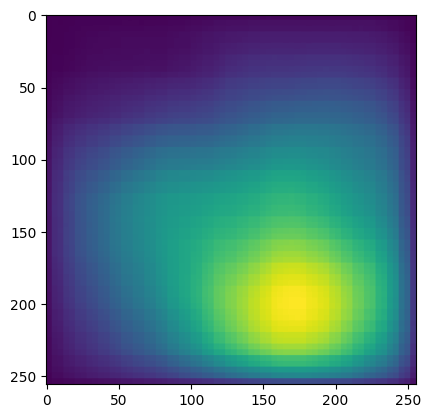

In [ ]:
import matplotlib.pyplot as plt

sample_image, sample_mask = next(iter(val_dataset.take(1)))
predicted_mask = myTransferModel.predict(sample_image)
plt.imshow(predicted_mask[0, :, :, 0])

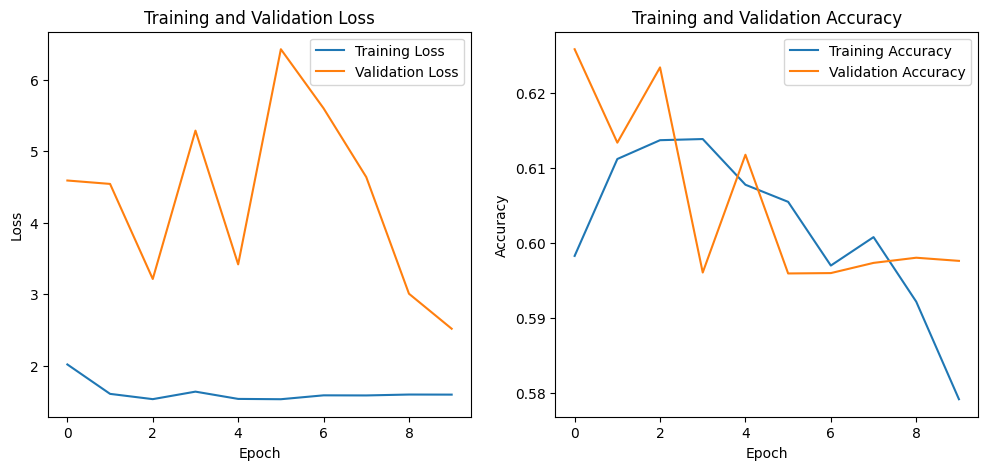

In [ ]:
plot_history(history_phase2)

In [ ]:
model1_performance_matrix = evaluate_model(myTransferModel, X_val, y_val)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Validation Performance:
Accuracy: 0.5977
F1-Score: 0.1148
Kappa Coefficient: 0.0095


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


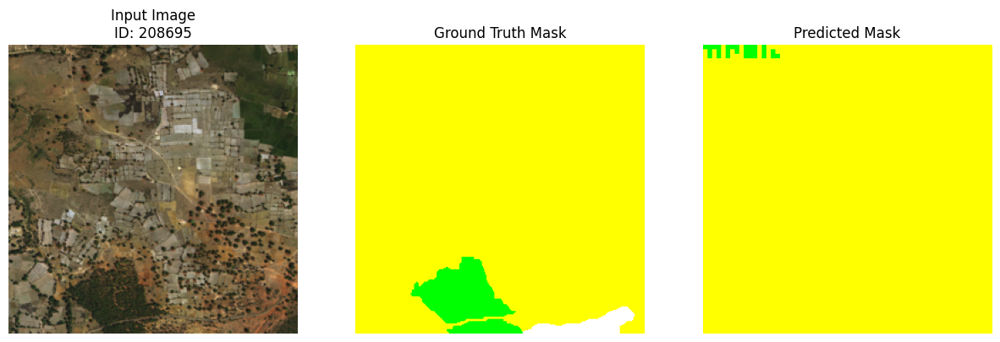

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


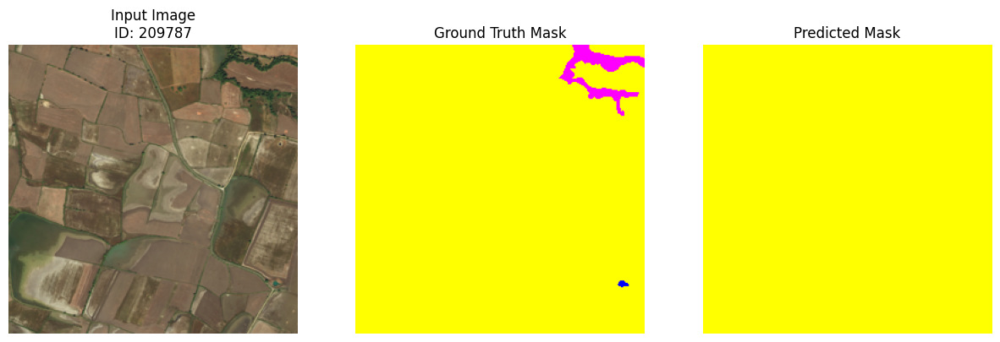

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


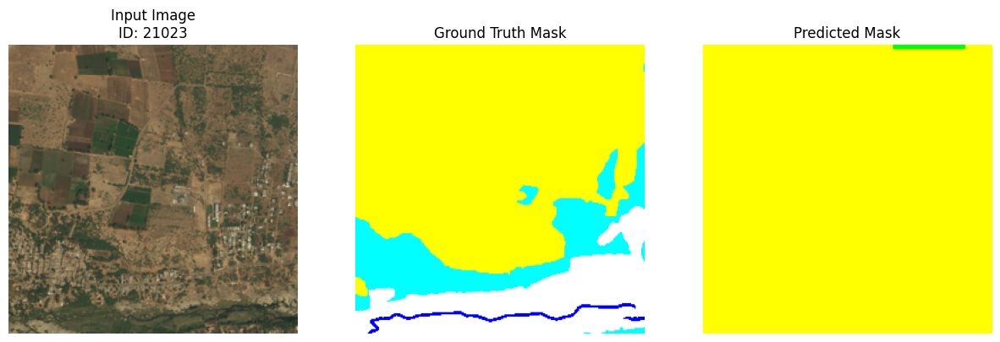

In [ ]:
# Call the function to visualize
start_idx = 100

visualize_predictions_ordered(myTransferModel, X, y, image_ids, start_idx=start_idx, num_images=3)

### UNET

In [ ]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.layers import Input, Conv2D, UpSampling2D, Concatenate
from tensorflow.keras.applications import MobileNetV2


def upsample_and_concatenate(decoder_input, skip_connection, filters):
    """
    Upsamples the decoder input and concatenates it with the skip connection.
    """
    x = UpSampling2D(size=(2, 2), interpolation="bilinear")(decoder_input)
    x = Concatenate()([x, skip_connection])
    x = Conv2D(filters, kernel_size=3, activation="relu", padding="same")(x)
    x = Conv2D(filters, kernel_size=3, activation="relu", padding="same")(x)
    return x

def build_unet_mobilenetv2(input_shape, num_classes):
    base_model = MobileNetV2(weights="imagenet", include_top=False, input_shape=input_shape)

    skip_connections = [
        base_model.get_layer("block_1_expand_relu").output,
        base_model.get_layer("block_3_expand_relu").output,
        base_model.get_layer("block_6_expand_relu").output,
        base_model.get_layer("block_13_expand_relu").output
    ]
    encoder_output = base_model.get_layer("block_16_project").output

    filters = [512, 256, 128, 64]
    x = encoder_output
    for i in range(len(filters)):
        x = upsample_and_concatenate(x, skip_connections[-(i + 1)], filters[i])

    x = UpSampling2D(size=(2, 2), interpolation="bilinear")(x)
    output = Conv2D(num_classes, kernel_size=1, activation="softmax", padding="same")(x)

    model = Model(inputs=base_model.input, outputs=output)
    return model, base_model


INPUT_SHAPE = (256, 256, 3)
NUM_CLASSES = len(color_map)


unet_model, unet_base_model = build_unet_mobilenetv2(INPUT_SHAPE, NUM_CLASSES)

for layer in unet_base_model.layers:
    layer.trainable = False

unet_model.compile(
    optimizer="adam",
    loss="sparse_categorical_crossentropy",
)

unet_model.summary()




<ipython-input-19-64b5ed02f24e>:20: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights="imagenet", include_top=False, input_shape=input_shape)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 128, 128, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 128, 128, 32)   │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 128, 128, 32)   │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 128, 128, 32)   │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 128, 128, 32)   │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 128, 128, 32)   │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 128, 128, 16)   │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 128, 128, 16)   │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 128, 128, 96)   │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 128, 128, 96)   │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 128, 128, 96)   │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 129, 129, 96)   │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 64, 64, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise_BN 

 Total params: 11,318,407 (43.18 MB)

 Trainable params: 9,476,423 (36.15 MB)

 Non-trainable params: 1,841,984 (7.03 MB)

In [ ]:
# Train the model
history2_1 = unet_model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=20
)

Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 50s 640ms/step - accuracy: 0.5498 - loss: 4.1081 - val_accuracy: 0.6517 - val_loss: 1.0508
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 116ms/step - accuracy: 0.6546 - loss: 1.0398 - val_accuracy: 0.6884 - val_loss: 0.8945
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 116ms/step - accuracy: 0.6916 - loss: 0.9272 - val_accuracy: 0.6968 - val_loss: 1.0071
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 116ms/step - accuracy: 0.7134 - loss: 0.8636 - val_accuracy: 0.6907 - val_loss: 0.8939
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 116ms/step - accuracy: 0.7067 - loss: 0.8390 - val_accuracy: 0.7320 - val_loss: 0.7997
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 116ms/step - accuracy: 0.7378 - loss: 0.7747 - val_accuracy: 0.7418 - val_loss: 0.8826
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 117ms/step - accuracy: 0.7516 - loss: 0.7520 - val_accuracy: 0.7444 - val_loss: 0.7700
Epoch 8/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 117ms/step - accuracy: 0.7659 - loss: 0.7018 - val_accuracy: 0

In [ ]:
for layer in unet_base_model.layers:
    layer.trainable = True


unet_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)
history2_2 = unet_model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=20
)

Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 74s 763ms/step - accuracy: 0.6283 - loss: 1.0211 - val_accuracy: 0.7435 - val_loss: 0.8024
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 151ms/step - accuracy: 0.7612 - loss: 0.6964 - val_accuracy: 0.7519 - val_loss: 0.7935
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 151ms/step - accuracy: 0.7864 - loss: 0.6358 - val_accuracy: 0.7537 - val_loss: 0.7821
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 152ms/step - accuracy: 0.7682 - loss: 0.6707 - val_accuracy: 0.7590 - val_loss: 0.7663
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 151ms/step - accuracy: 0.7817 - loss: 0.6306 - val_accuracy: 0.7560 - val_loss: 0.7704
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 151ms/step - accuracy: 0.7881 - loss: 0.6307 - val_accuracy: 0.7592 - val_loss: 0.7614
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 150ms/step - accuracy: 0.7912 - loss: 0.6126 - val_accuracy: 0.7549 - val_loss: 0.7606
Epoch 8/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 6s 150ms/step - accuracy: 0.7986 - loss: 0.5955 - val_accuracy: 0

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


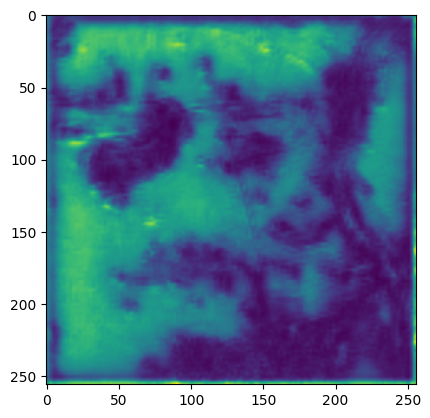

In [ ]:
import matplotlib.pyplot as plt

sample_image, sample_mask = next(iter(val_dataset.take(1)))
predicted_mask = unet_model.predict(sample_image)
plt.imshow(predicted_mask[0, :, :, 0])

### Model2

In [ ]:
from tensorflow.keras import layers, Model
def build_model2(input_shape=(256, 256, 3)):
    base_model = ResNet101V2(weights='imagenet', include_top=False, input_shape=input_shape)

    x = base_model.output

    x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)

    x = layers.Conv2D(NUM_CLASSES, (1, 1), activation="softmax", padding='same')(x)

    model = Model(inputs=base_model.input, outputs=x)

    return model, base_model


model2, base_model2 = build_model2(input_shape=(256, 256, 3))
model2.summary()

Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 262, 262, 3)    │              0 │ input_layer_8[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 128, 128, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 130, 130, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 64, 64, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 64, 64, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 64, 64, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 64, 64, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 66, 66, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 64, 64, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv  

 Total params: 47,737,447 (182.10 MB)

 Trainable params: 47,639,783 (181.73 MB)

 Non-trainable params: 97,664 (381.50 KB)

In [ ]:
for layer in base_model2.layers:
    layer.trainable = False

model2.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the top layers
model2.fit(train_dataset, validation_data=val_dataset,epochs=10)

Epoch 1/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 44s 471ms/step - accuracy: 0.5054 - loss: 4.6847 - val_accuracy: 0.5902 - val_loss: 4.7214
Epoch 2/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.5609 - loss: 4.2721 - val_accuracy: 0.0939 - val_loss: 3.4755
Epoch 3/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.0869 - loss: 3.2905 - val_accuracy: 0.0918 - val_loss: 3.4833
Epoch 4/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.3660 - loss: 3.2901 - val_accuracy: 0.5767 - val_loss: 3.4666
Epoch 5/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.5375 - loss: 3.4834 - val_accuracy: 0.5724 - val_loss: 3.4666
Epoch 6/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.5540 - loss: 3.3008 - val_accuracy: 0.5721 - val_loss: 3.4666
Epoch 7/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 64ms/step - accuracy: 0.5478 - loss: 3.2683 - val_accuracy: 0.5716 - val_loss: 3.4666
Epoch 8/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.5291 - loss: 3.3272 - val_accuracy: 0.5712 -

In [ ]:
for layer in base_model2.layers:
    layer.trainable = True

model2.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the top layers
model2.fit(train_dataset, validation_data=val_dataset,epochs=10)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


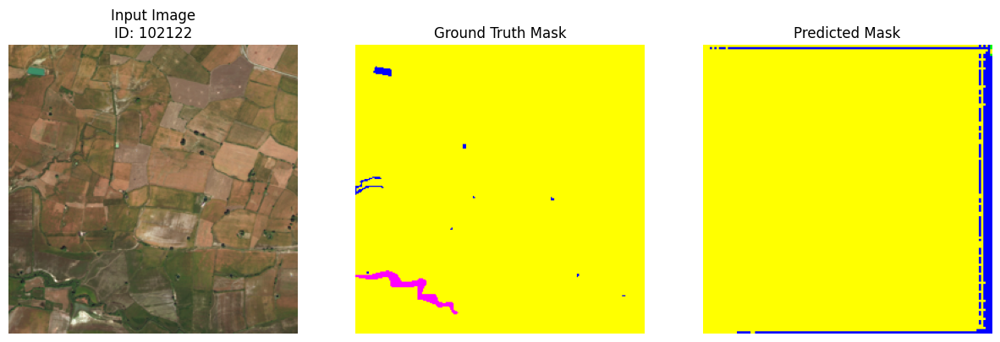

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


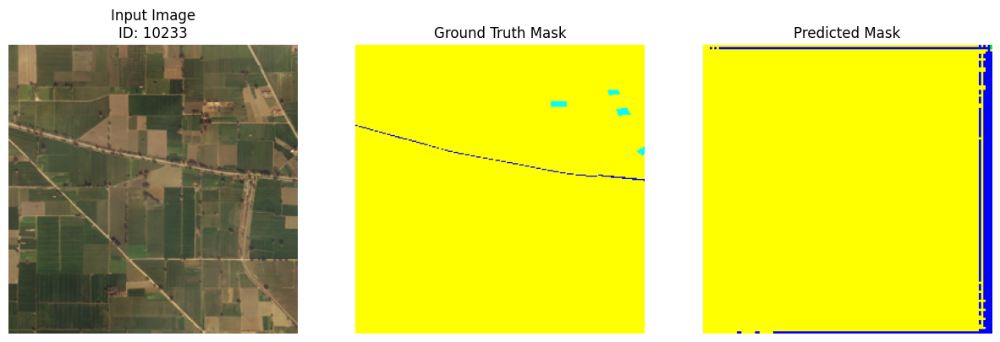

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


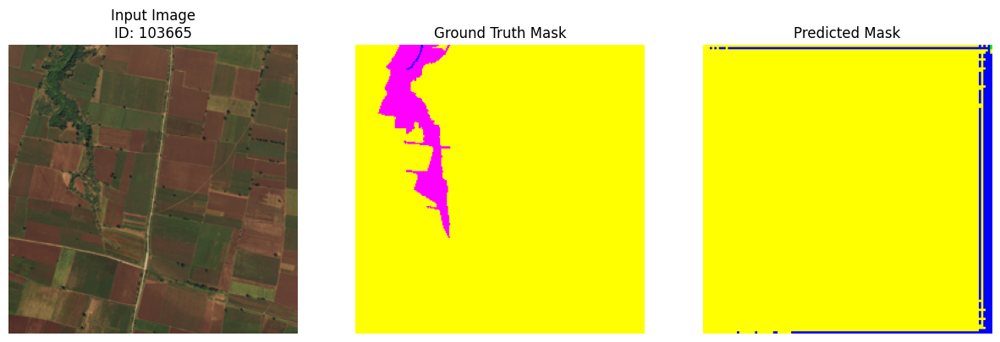

In [ ]:
start_idx = 1  # Start from the first image

visualize_predictions_ordered(model2, X, y, image_ids, start_idx=start_idx, num_images=3)

### **Model3 (best model)

In [ ]:
def model3(input_shape=(256, 256, 3), num_classes=7):

    base_model = ResNet101V2(weights='imagenet', include_top=False, input_shape=input_shape)

    # Get intermediate feature maps from the base model for skip connections
    skip1 = base_model.get_layer('conv2_block3_out').output  # Skip from early layer
    skip2 = base_model.get_layer('conv3_block4_out').output  # Skip from middle layer
    skip3 = base_model.get_layer('conv4_block23_out').output  # Skip from deeper layer

    x = base_model.output
    x = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.UpSampling2D((2, 2))(x)

    skip3 = layers.Conv2D(512, (1, 1), activation='relu', padding='same')(skip3)
    skip3 = layers.UpSampling2D((2, 2))(skip3)
    x = layers.Concatenate()([x, skip3])
    x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.UpSampling2D((2, 2))(x)


    skip2 = layers.Conv2D(256, (1, 1), activation='relu', padding='same')(skip2)
    skip2 = layers.UpSampling2D((2, 2))(skip2)
    x = layers.Concatenate()([x, skip2])
    x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.UpSampling2D((2, 2))(x)


    skip1 = layers.Conv2D(128, (1, 1), activation='relu', padding='same')(skip1)
    skip1 = layers.UpSampling2D((2, 2))(skip1)
    x = layers.Concatenate()([x, skip1])
    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.UpSampling2D((2, 2))(x)


    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)

    x = layers.Conv2D(num_classes, (1, 1), activation='softmax', padding='same')(x)

    model = Model(inputs=base_model.input, outputs=x)

    return model, base_model

model3, base_model3 = model3(input_shape=(256, 256, 3))
model3.summary()

Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_12            │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 262, 262, 3)    │              0 │ input_layer_12[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 128, 128, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 130, 130, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 64, 64, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 64, 64, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 64, 64, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 64, 64, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 66, 66, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 64, 64, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv  

 Total params: 55,910,151 (213.28 MB)

 Trainable params: 55,810,375 (212.90 MB)

 Non-trainable params: 99,776 (389.75 KB)

In [ ]:
for layer in base_model3.layers:
    layer.trainable = False

model3.compile(optimizer='nadam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the top layers
model3.fit(train_dataset, validation_data=val_dataset,epochs=10)

Epoch 1/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 58s 684ms/step - accuracy: 0.5559 - loss: 1.4992 - val_accuracy: 0.5404 - val_loss: 2.0912
Epoch 2/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 115ms/step - accuracy: 0.7523 - loss: 0.8715 - val_accuracy: 0.6557 - val_loss: 1.2235
Epoch 3/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 114ms/step - accuracy: 0.7731 - loss: 0.7547 - val_accuracy: 0.5560 - val_loss: 2.0026
Epoch 4/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 114ms/step - accuracy: 0.8006 - loss: 0.6433 - val_accuracy: 0.7713 - val_loss: 0.9246
Epoch 5/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 115ms/step - accuracy: 0.8405 - loss: 0.5053 - val_accuracy: 0.7764 - val_loss: 0.8687
Epoch 6/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 114ms/step - accuracy: 0.8573 - loss: 0.4670 - val_accuracy: 0.7834 - val_loss: 0.8459
Epoch 7/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 114ms/step - accuracy: 0.8664 - loss: 0.4246 - val_accuracy: 0.7693 - val_loss: 0.8393
Epoch 8/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 114ms/step - accuracy: 0.8749 - loss: 0.3948 - val_accuracy: 0

In [ ]:
model3copy=model3

In [ ]:
save_model(model3,"model3_7753_half.keras")

Model successfully saved to saved_model/model3_7753_half.keras
Error saving or downloading model: name 'zip_path' is not defined


In [ ]:
for layer in base_model3.layers:
    layer.trainable = True

model3.compile(optimizer=tf.keras.optimizers.Nadam(learning_rate=5e-5), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model3.fit(train_dataset, validation_data=val_dataset,epochs=20)

Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 175s 2s/step - accuracy: 0.7460 - loss: 0.8354 - val_accuracy: 0.6755 - val_loss: 1.3373
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 198ms/step - accuracy: 0.8170 - loss: 0.5717 - val_accuracy: 0.7032 - val_loss: 1.1931
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 197ms/step - accuracy: 0.8430 - loss: 0.4788 - val_accuracy: 0.7173 - val_loss: 1.0762
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 200ms/step - accuracy: 0.8631 - loss: 0.4274 - val_accuracy: 0.7315 - val_loss: 0.9845
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 198ms/step - accuracy: 0.8770 - loss: 0.3820 - val_accuracy: 0.7598 - val_loss: 0.8409
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 197ms/step - accuracy: 0.8859 - loss: 0.3547 - val_accuracy: 0.7752 - val_loss: 0.7768
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 197ms/step - accuracy: 0.8880 - loss: 0.3466 - val_accuracy: 0.7822 - val_loss: 0.7399
Epoch 8/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 8s 194ms/step - accuracy: 0.8879 - loss: 0.3494 - val_accuracy: 0.7

In [ ]:
save_model(model3,"model3_8013.keras")

Model successfully saved to saved_model/model3_8013.keras
Error saving or downloading model: name 'zip_path' is not defined


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


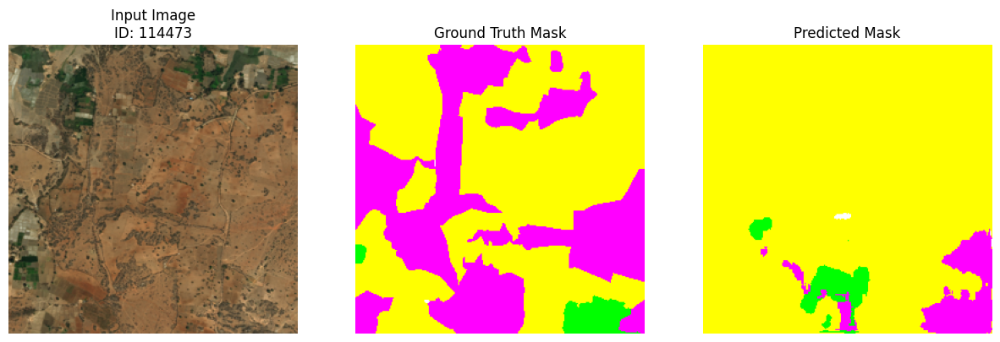

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


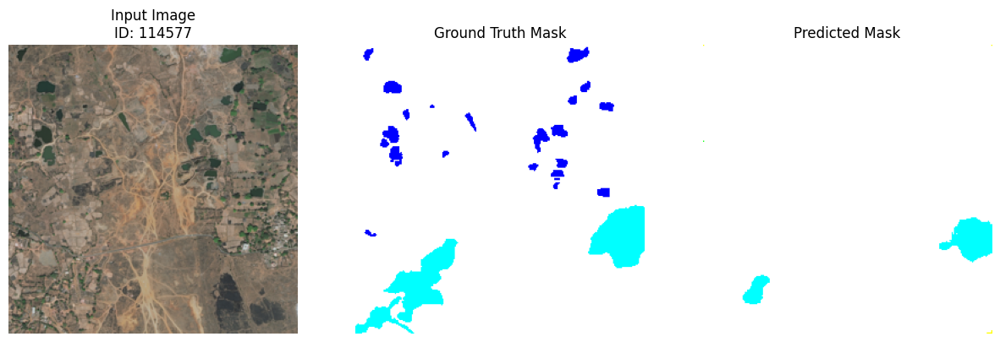

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


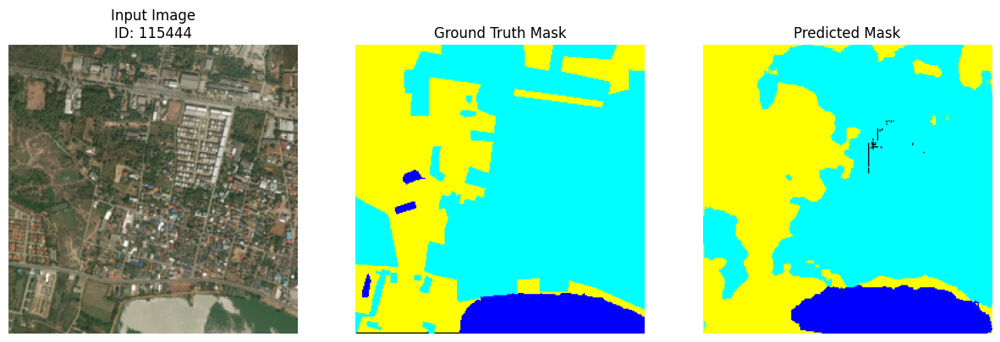

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


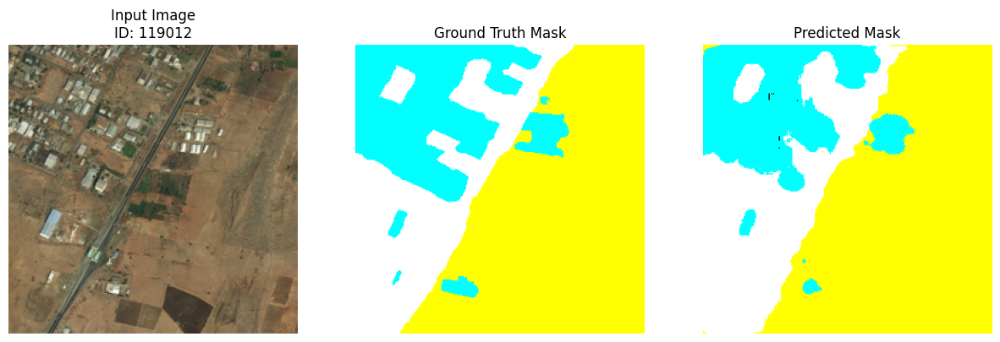

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


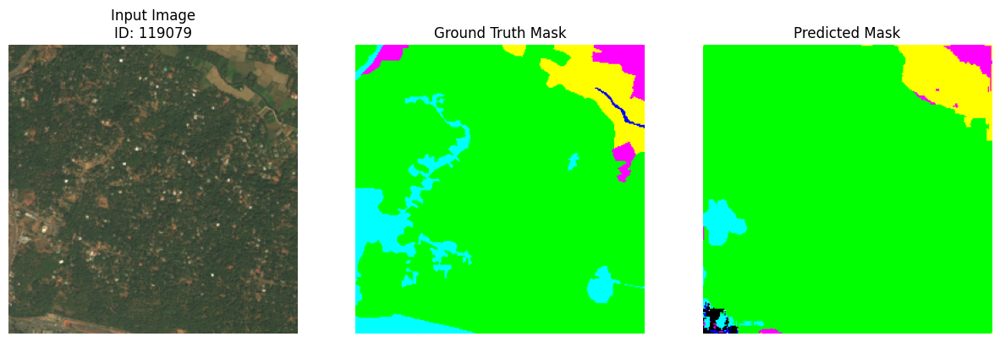

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


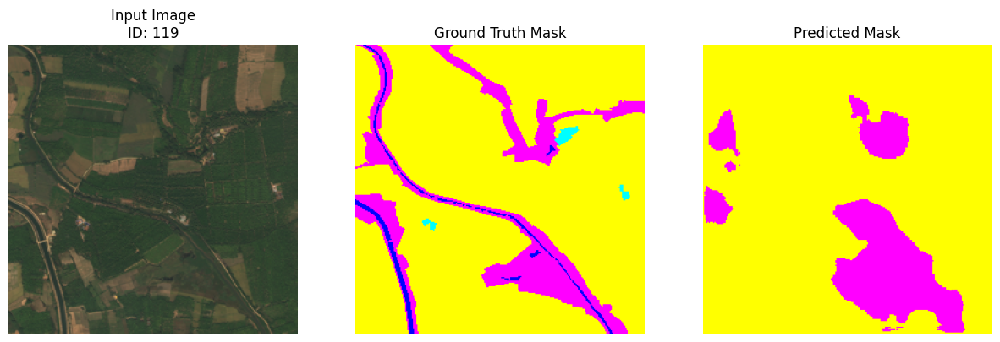

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


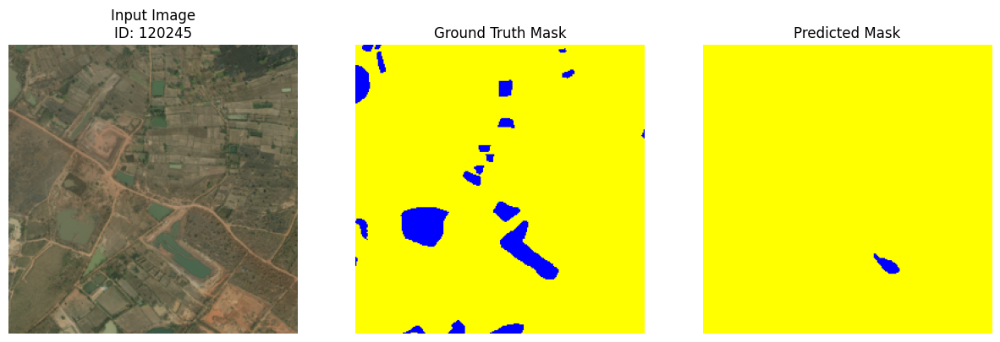

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


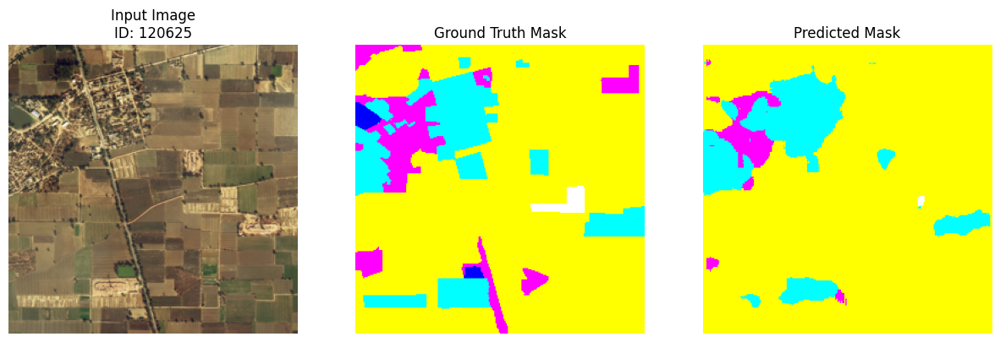

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


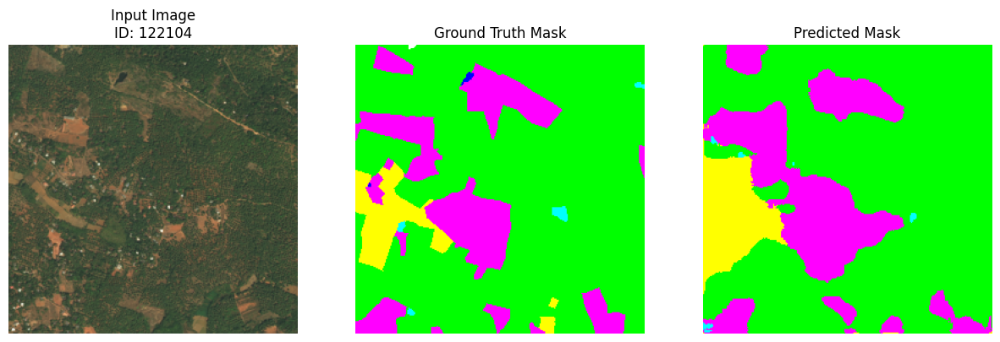

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


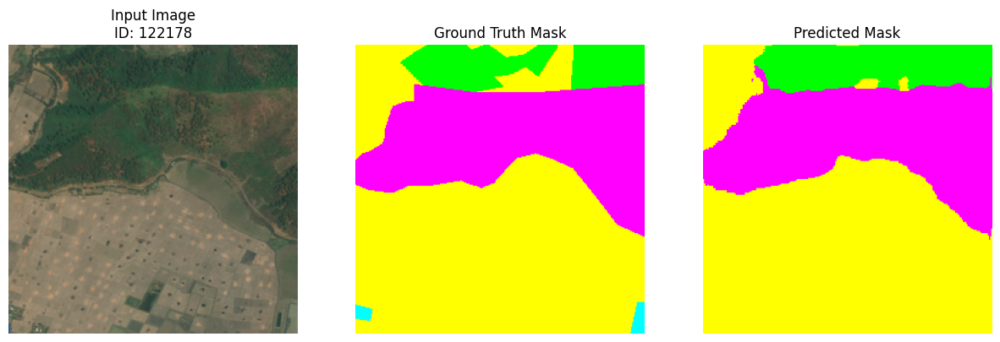

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


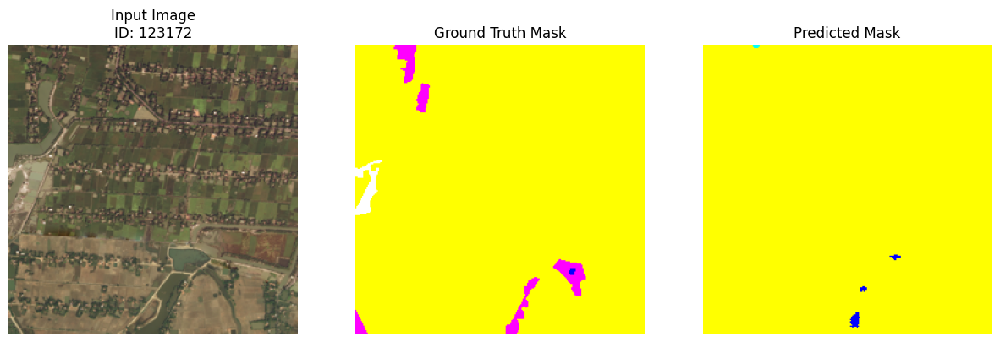

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


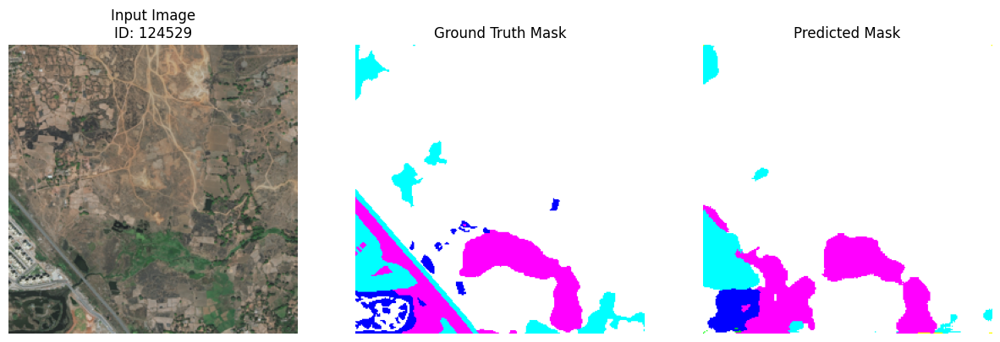

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


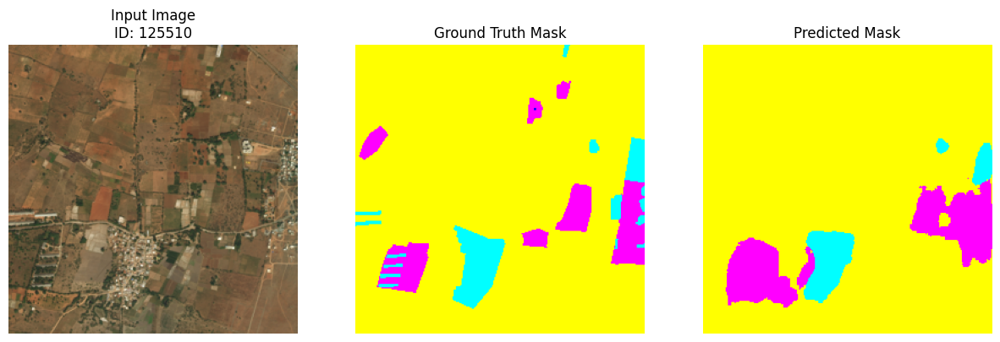

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


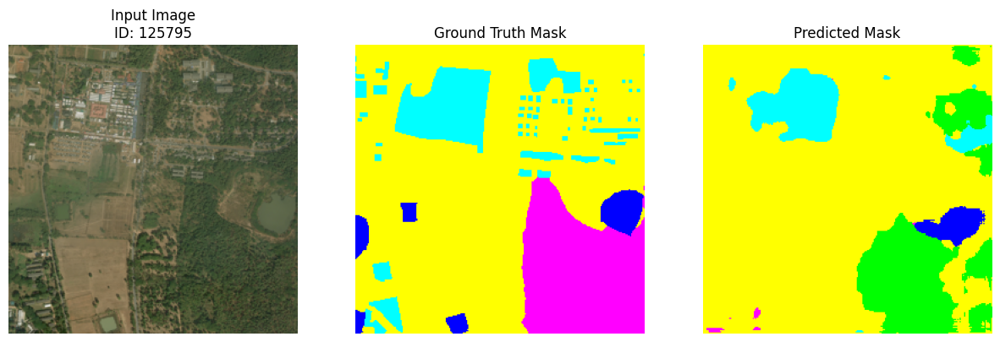

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


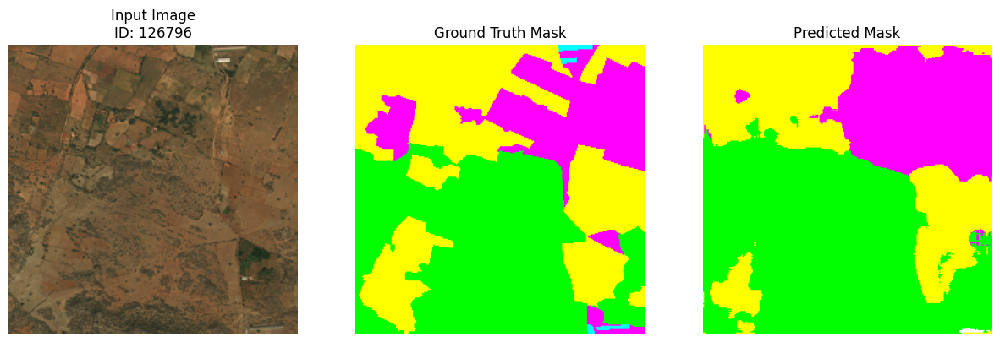

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


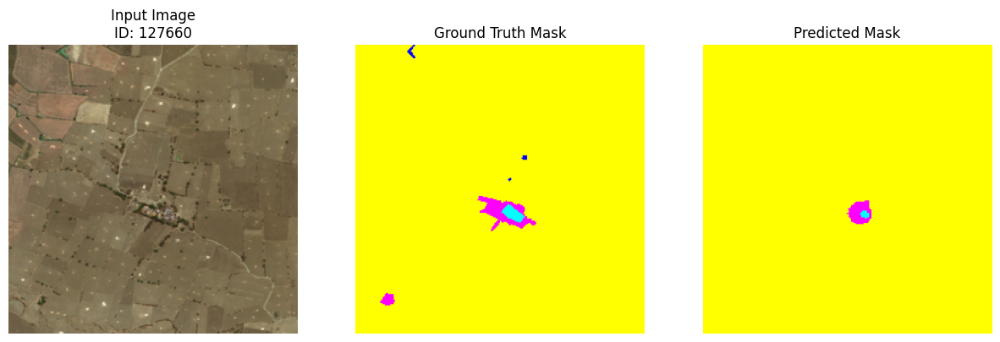

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


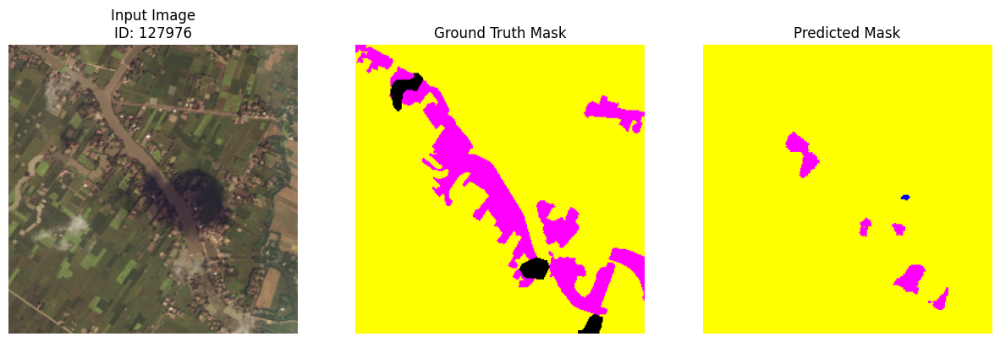

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


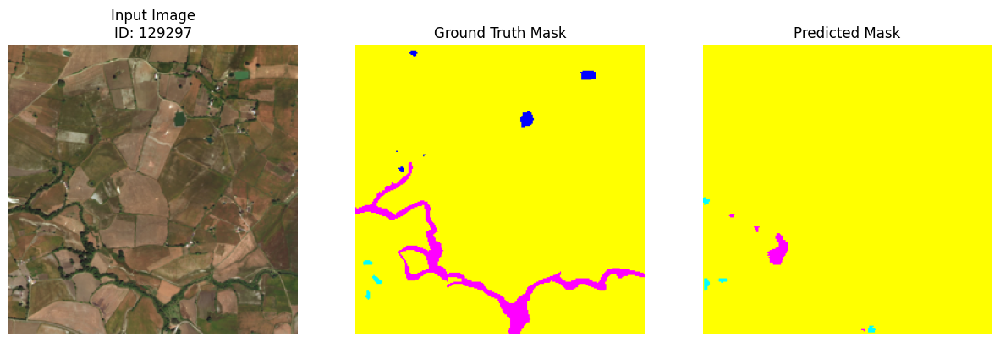

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


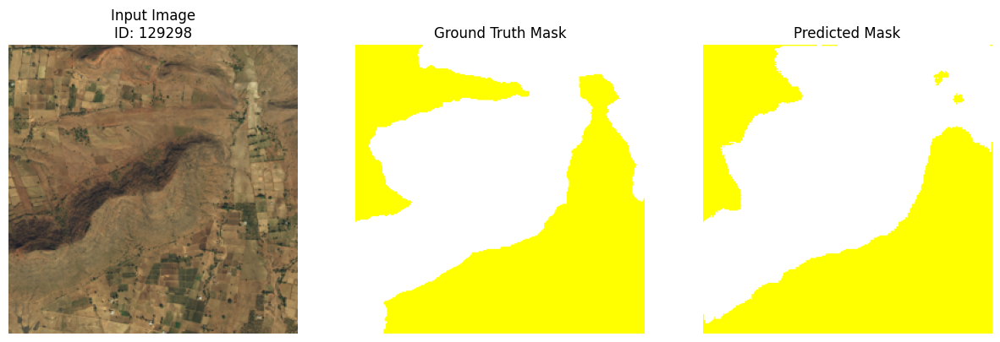

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


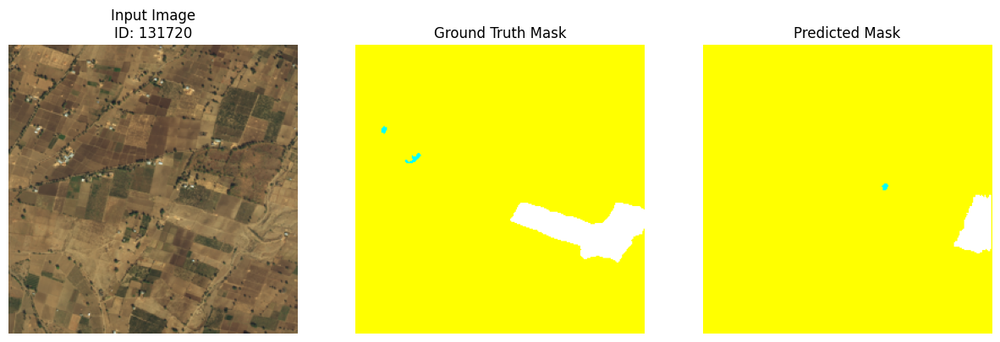

In [ ]:
start_idx = 10  # Start from the 10th image

visualize_predictions_ordered(model3, X, y, image_ids, start_idx=start_idx, num_images=20)

In [ ]:
model3_performance_metrics = evaluate_model(model3, X_val, y_val)

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step
Validation Performance:
Accuracy: 0.8013
F1-Score: 0.5775
Kappa Coefficient: 0.6457


In [ ]:
model3_load=load_model("model3_8013.keras")
model3_load.summary()

Model successfully loaded from ./saved_model/model3_8013.keras


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_12            │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 262, 262, 3)    │              0 │ input_layer_12[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 128, 128, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 130, 130, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 64, 64, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 64, 64, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 64, 64, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 64, 64, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 66, 66, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 64, 64, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv  

 Total params: 167,530,904 (639.08 MB)

 Trainable params: 55,810,375 (212.90 MB)

 Non-trainable params: 99,776 (389.75 KB)

 Optimizer params: 111,620,753 (425.80 MB)

In [ ]:
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
callbacks = [
    EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
]

@tf.keras.utils.register_keras_serializable()
def dice_loss(y_true, y_pred):
    smooth = 1.0
    y_true_flat = tf.reshape(tf.one_hot(tf.cast(y_true, tf.int32), depth=7), [-1])
    y_pred_flat = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_flat * y_pred_flat)
    return 1 - (2. * intersection + smooth) / (tf.reduce_sum(y_true_flat) + tf.reduce_sum(y_pred_flat) + smooth)

In [ ]:
model3_load.compile(optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-5), loss=dice_loss, metrics=['accuracy',Custom_f1_score ,Custom_kappa_coefficient])
history_3 = model3_load.fit(train_images_augmented, validation_data=val_dataset, epochs=20, batch_size=16,callbacks=callbacks)

Epoch 1/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 169s 745ms/step - accuracy: 0.6861 - custom_f1_score: 0.3756 - custom_kappa_coefficient: 0.4611 - loss: 0.3686 - val_accuracy: 0.8005 - val_custom_f1_score: 0.5058 - val_custom_kappa_coefficient: 0.6648 - val_loss: 0.2471
Epoch 2/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 10s 113ms/step - accuracy: 0.7082 - custom_f1_score: 0.3824 - custom_kappa_coefficient: 0.4899 - loss: 0.3383 - val_accuracy: 0.7720 - val_custom_f1_score: 0.4700 - val_custom_kappa_coefficient: 0.6123 - val_loss: 0.2728
Epoch 3/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 10s 113ms/step - accuracy: 0.7047 - custom_f1_score: 0.3921 - custom_kappa_coefficient: 0.4958 - loss: 0.3324 - val_accuracy: 0.7714 - val_custom_f1_score: 0.4732 - val_custom_kappa_coefficient: 0.5887 - val_loss: 0.2674
Epoch 4/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 10s 113ms/step - accuracy: 0.7362 - custom_f1_score: 0.4075 - custom_kappa_coefficient: 0.5439 - loss: 0.2993 - val_accuracy: 0.7773 - val_custom_f1_score: 0.4777 - val_custom_kappa_co

In [ ]:
save_model(model3_load,"model3_7884_tune1.keras")

Model successfully saved to saved_model/model3_7884_tune1.keras


### model5

In [ ]:
from tensorflow.keras import models
def build_model5(input_shape=(256, 256, 3)):
    model = models.Sequential([
        layers.InputLayer(input_shape=input_shape),
        layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
        layers.UpSampling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.UpSampling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.UpSampling2D((2, 2)),
        layers.Conv2D(7, (3, 3), activation='softmax', padding='same')
    ])
    return model

model5 = build_model5()
model5.summary()

Model: "sequential_122"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_166 (Conv2D)                  │ (None, 256, 256, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_38 (MaxPooling2D)      │ (None, 128, 128, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_167 (Conv2D)                  │ (None, 128, 128, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_39 (MaxPooling2D)      │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_168 (Conv2D)                  │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_40 (MaxPooling2D)      │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_169 (Conv2D)                  │ (None, 32, 32, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_38 (UpSampling2D)      │ (None, 64, 64, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_170 (Conv2D)                  │ (None, 64, 64, 128)         │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_39 (UpSampling2D)      │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_171 (Conv2D)                  │ (None, 128, 128, 64)        │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_40 (UpSampling2D)      │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_172 (Conv2D)                  │ (None, 256, 256, 7)         │           4,039 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 761,287 (2.90 MB)

 Trainable params: 761,287 (2.90 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model5.compile(optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-4), loss="sparse_categorical_crossentropy", metrics=['accuracy',Custom_f1_score ,Custom_kappa_coefficient])

history_5 = model5.fit(train_dataset, validation_data=val_dataset, epochs=50, batch_size=8,callbacks=callbacks)

Epoch 1/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 27s 311ms/step - accuracy: 0.5562 - custom_f1_score: 0.1040 - custom_kappa_coefficient: -0.0034 - loss: 1.7107 - val_accuracy: 0.5960 - val_custom_f1_score: 0.0979 - val_custom_kappa_coefficient: 0.0000e+00 - val_loss: 1.3841
Epoch 2/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - accuracy: 0.5828 - custom_f1_score: 0.1047 - custom_kappa_coefficient: 0.0000e+00 - loss: 1.3761 - val_accuracy: 0.5960 - val_custom_f1_score: 0.1077 - val_custom_kappa_coefficient: 0.0000e+00 - val_loss: 1.3236
Epoch 3/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - accuracy: 0.5829 - custom_f1_score: 0.1046 - custom_kappa_coefficient: 0.0000e+00 - loss: 1.3371 - val_accuracy: 0.5960 - val_custom_f1_score: 0.1049 - val_custom_kappa_coefficient: 0.0000e+00 - val_loss: 1.2049
Epoch 4/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - accuracy: 0.5574 - custom_f1_score: 0.1080 - custom_kappa_coefficient: 0.0149 - loss: 1.2823 - val_accuracy: 0.6379 - val_custom_f1_score: 0.1668 - val_c

In [ ]:
model5.compile(optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-5), loss="sparse_categorical_crossentropy", metrics=['accuracy',Custom_f1_score ,Custom_kappa_coefficient])

temphis = model5.fit(train_dataset, validation_data=val_dataset, epochs=40, batch_size=8)

Epoch 1/40
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 164ms/step - accuracy: 0.7598 - custom_f1_score: 0.4345 - custom_kappa_coefficient: 0.5565 - loss: 0.7274 - val_accuracy: 0.7480 - val_custom_f1_score: 0.3962 - val_custom_kappa_coefficient: 0.4852 - val_loss: 0.7654
Epoch 2/40
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - accuracy: 0.7615 - custom_f1_score: 0.4322 - custom_kappa_coefficient: 0.5625 - loss: 0.7324 - val_accuracy: 0.7470 - val_custom_f1_score: 0.3856 - val_custom_kappa_coefficient: 0.4923 - val_loss: 0.7675
Epoch 3/40
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - accuracy: 0.7617 - custom_f1_score: 0.4219 - custom_kappa_coefficient: 0.5630 - loss: 0.7247 - val_accuracy: 0.7480 - val_custom_f1_score: 0.4054 - val_custom_kappa_coefficient: 0.5086 - val_loss: 0.7640
Epoch 4/40
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - accuracy: 0.7592 - custom_f1_score: 0.4105 - custom_kappa_coefficient: 0.5510 - loss: 0.7321 - val_accuracy: 0.7482 - val_custom_f1_score: 0.3977 - val_custom_kappa_coefficie

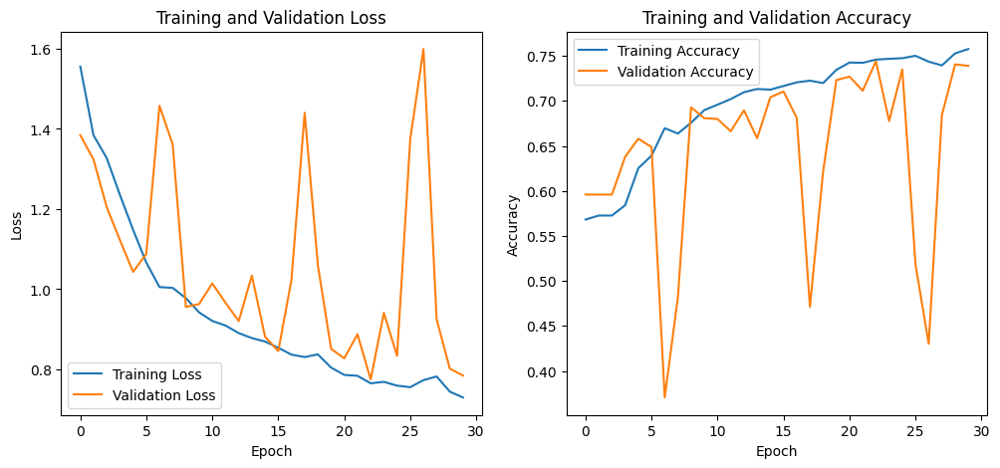

In [ ]:
plot_history(history_5)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


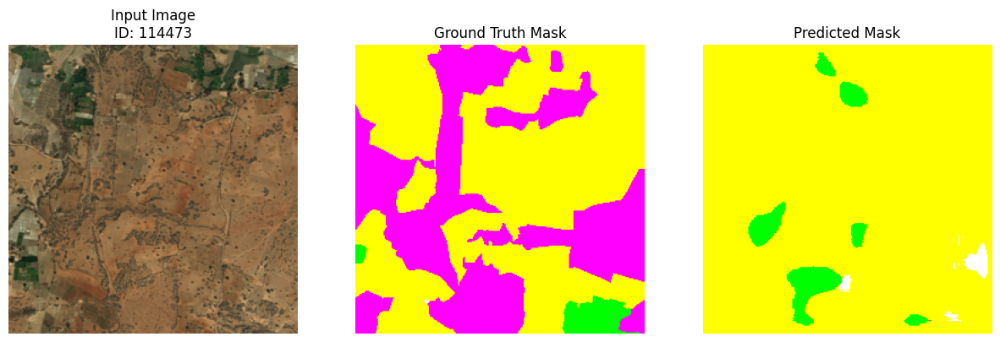

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


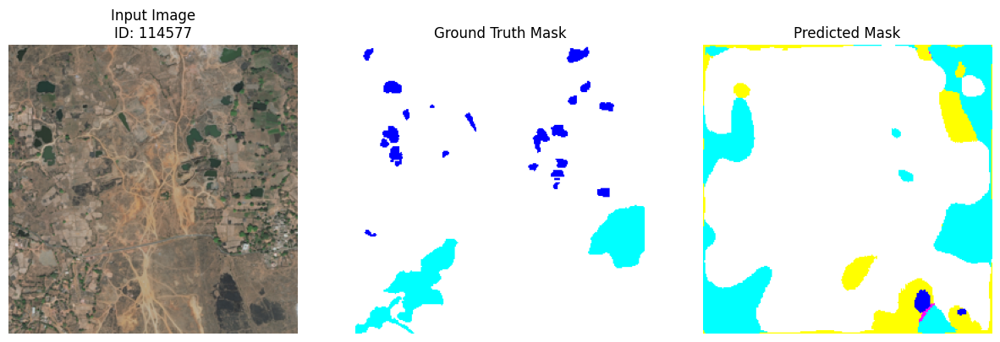

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


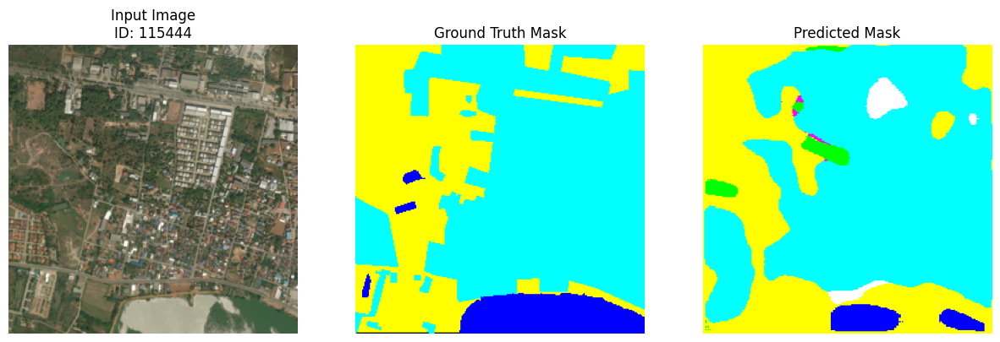

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


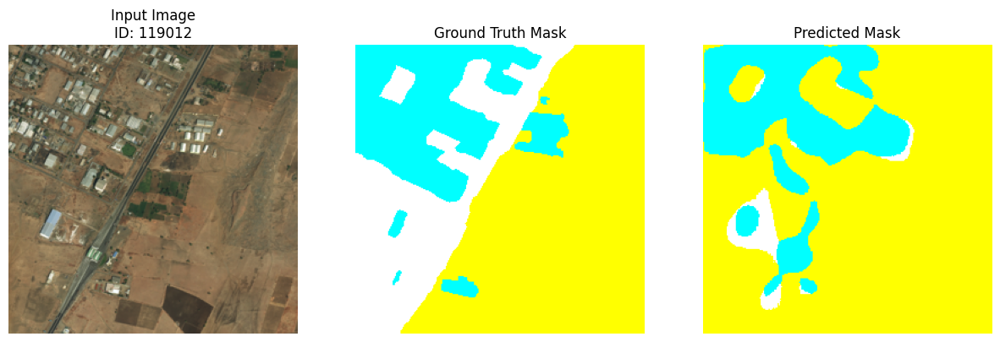

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


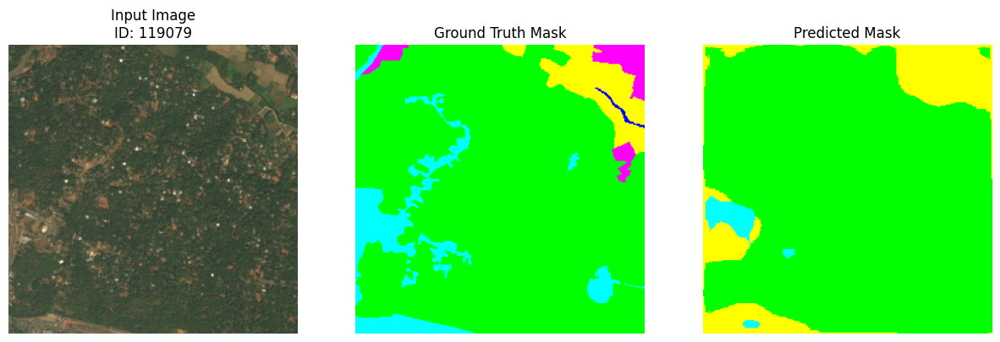

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


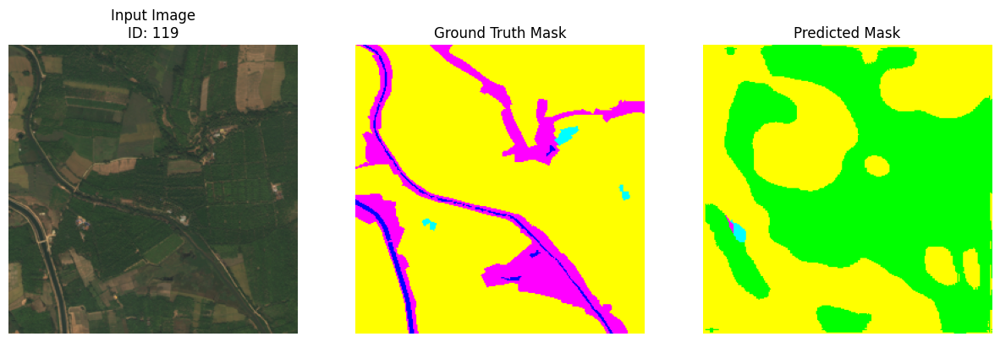

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


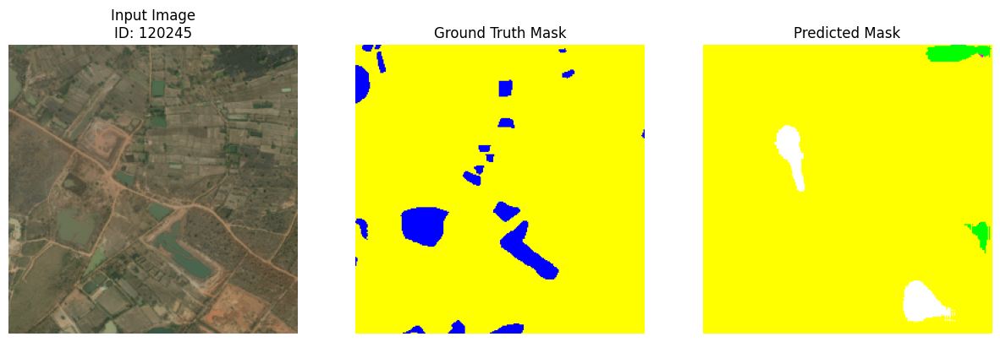

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


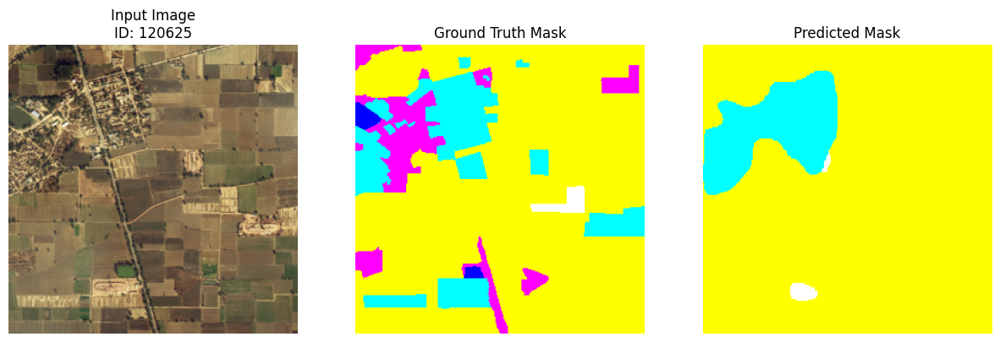

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


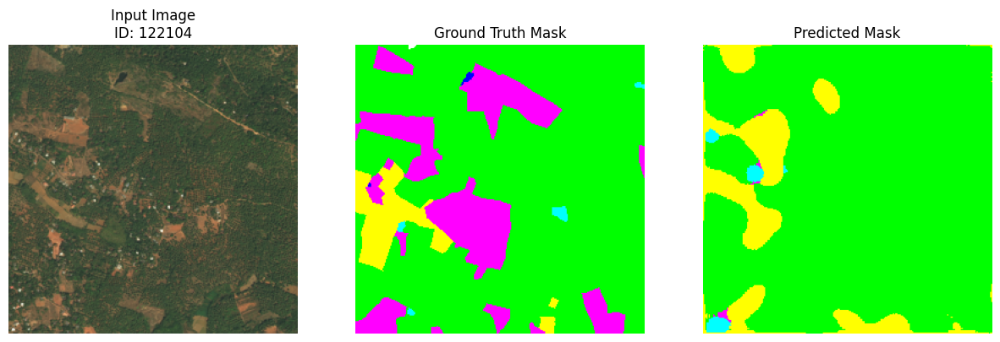

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


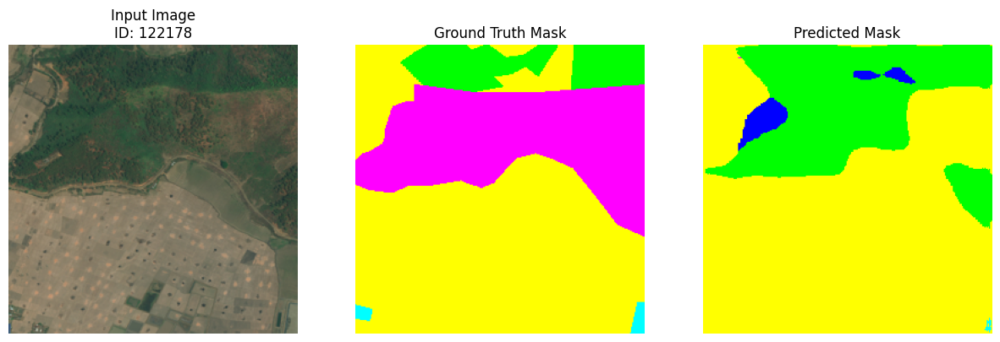

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


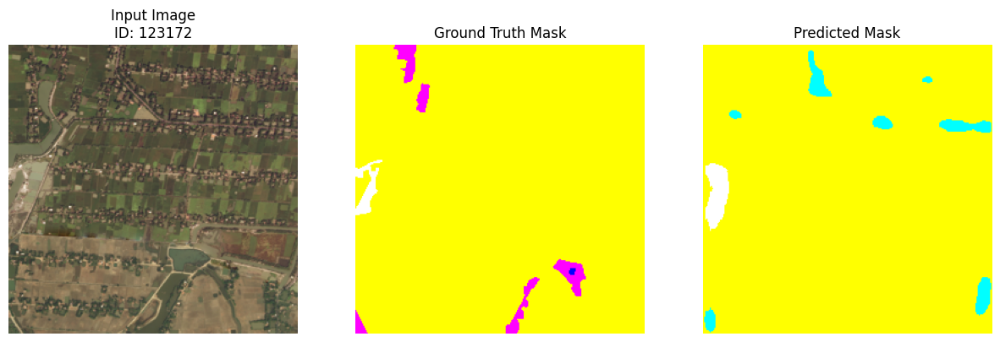

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


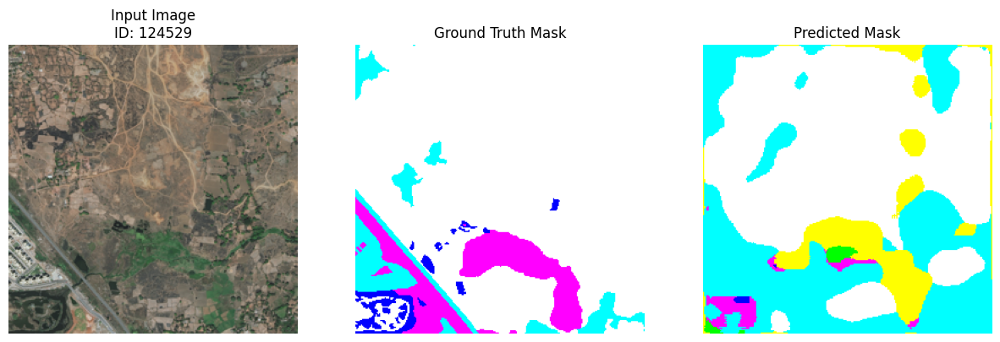

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


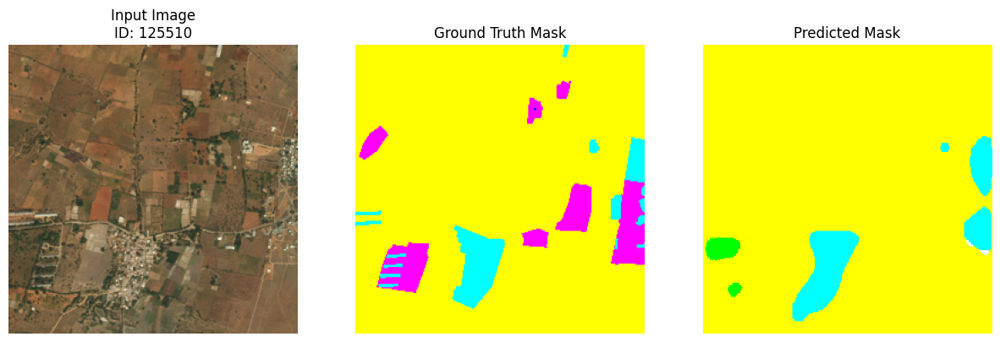

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


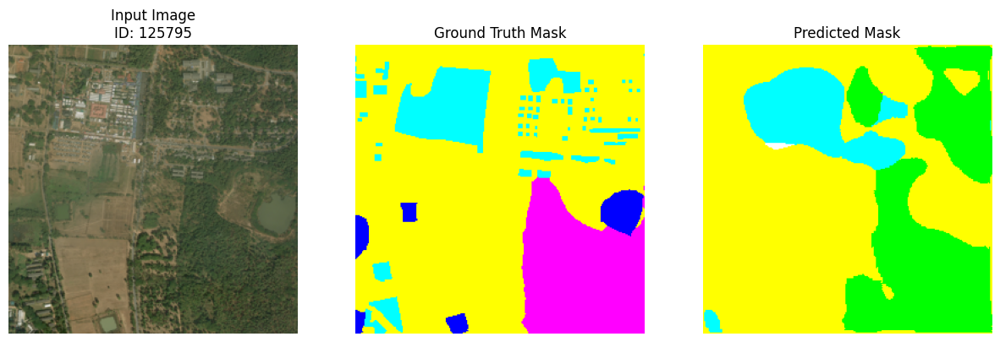

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


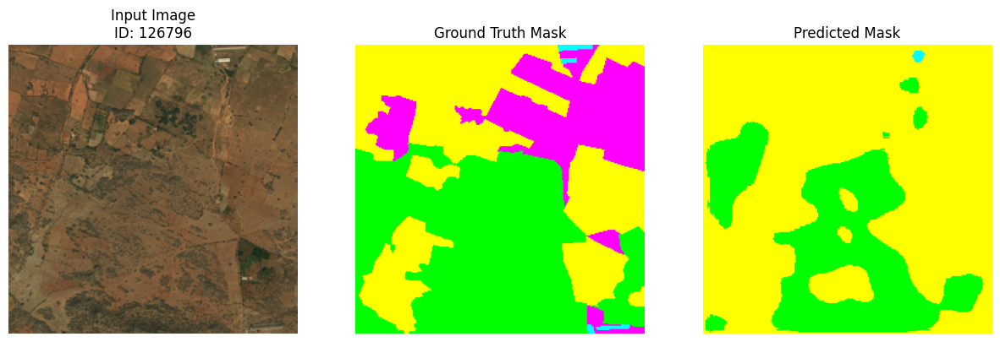

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


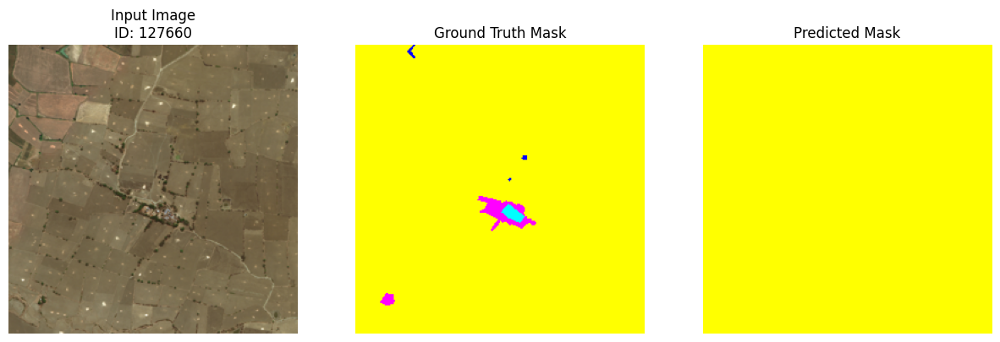

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


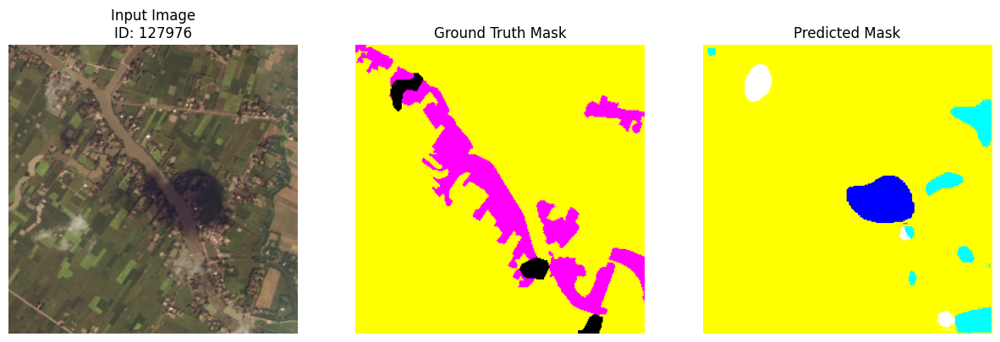

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


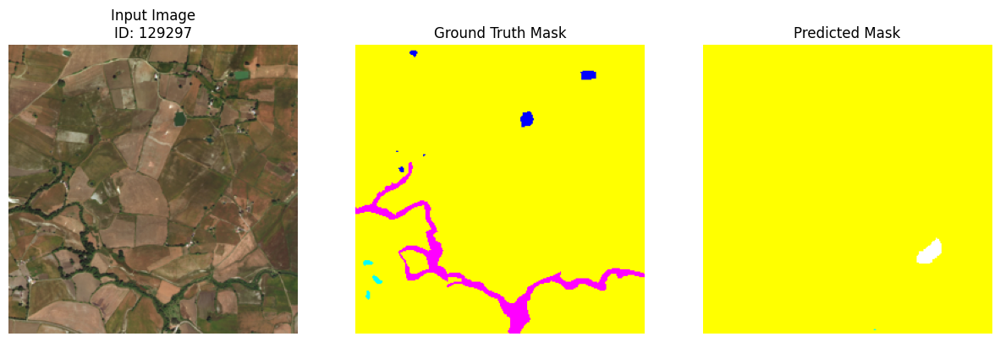

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


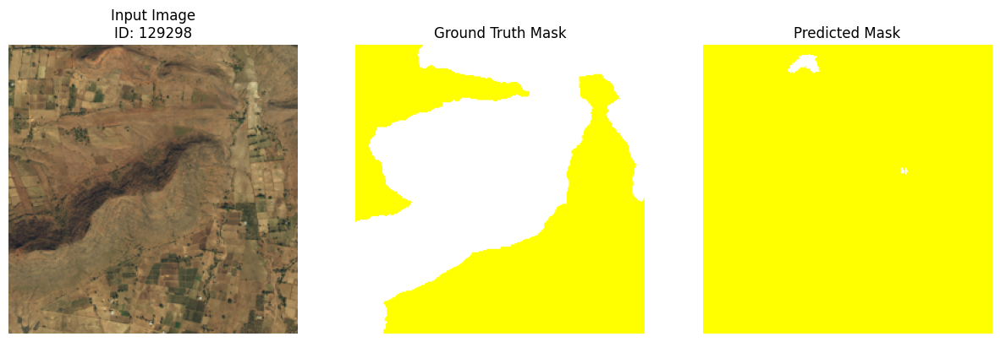

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


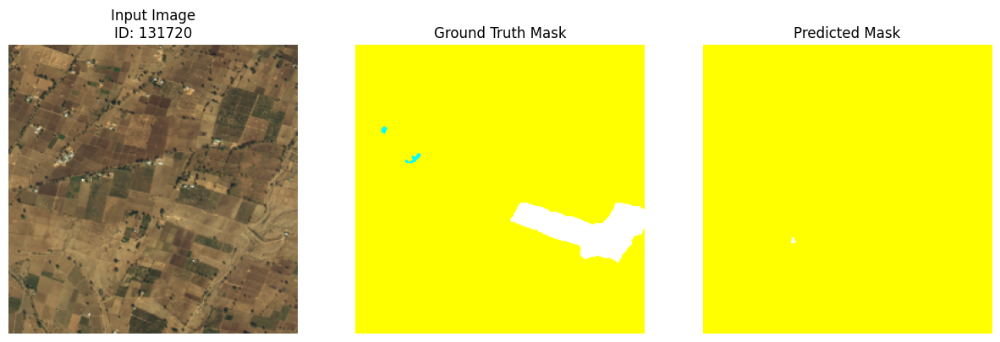

In [ ]:
start_idx = 10  # Start from the first image

visualize_predictions_ordered(model5, X, y, image_ids, start_idx=start_idx, num_images=20)

In [ ]:
save_model(model5,"model5_7568.keras")

Model successfully saved to saved_model/model5_7568.keras


### Deeplabv3+

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.applications import ResNet50

def DeepLabV3Plus(input_shape=(256, 256, 3), num_classes=7, backbone='resnet50'):

    if backbone == 'resnet50':
        base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
    else:
        raise ValueError("Currently, only 'resnet50' backbone is supported.")


    x4 = base_model.get_layer("conv4_block6_out").output
    x_low = base_model.get_layer("conv2_block3_out").output


    def ASPP(x):
      """Atrous Spatial Pyramid Pooling block."""
      atrous_rates = [6, 12, 18]

      conv1x1 = layers.Conv2D(filters=256,
        kernel_size=(1, 1),
        padding="same",
        kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
      conv1x1 = layers.BatchNormalization()(conv1x1)
      conv1x1 = layers.ReLU()(conv1x1)


      atrous_1 = layers.Conv2D(256, (3, 3), padding="same", dilation_rate=atrous_rates[0], use_bias=False)(x)
      atrous_1 = layers.BatchNormalization()(atrous_1)
      atrous_1 = layers.ReLU()(atrous_1)

      atrous_2 = layers.Conv2D(256, (3, 3), padding="same", dilation_rate=atrous_rates[1], use_bias=False)(x)
      atrous_2 = layers.BatchNormalization()(atrous_2)
      atrous_2 = layers.ReLU()(atrous_2)

      atrous_3 = layers.Conv2D(256, (3, 3), padding="same", dilation_rate=atrous_rates[2], use_bias=False)(x)
      atrous_3 = layers.BatchNormalization()(atrous_3)
      atrous_3 = layers.ReLU()(atrous_3)

      global_avg = layers.GlobalAveragePooling2D()(x)
      global_avg = layers.Reshape((1, 1, x.shape[-1]))(global_avg)  # Reshape to (1, 1, channels)
      global_avg = layers.Conv2D(256, (1, 1), padding="same", use_bias=False)(global_avg)
      global_avg = layers.BatchNormalization()(global_avg)
      global_avg = layers.ReLU()(global_avg)
      global_avg = layers.UpSampling2D(size=(x.shape[1], x.shape[2]), interpolation='bilinear')(global_avg)

      x = layers.Concatenate()([conv1x1, atrous_1, atrous_2, atrous_3, global_avg])
      x = layers.Conv2D(256, (1, 1), padding="same", use_bias=False)(x)
      x = layers.BatchNormalization()(x)
      x = layers.ReLU()(x)
      return x


    x_aspp = ASPP(x4)

    def Decoder(x, low_level_features):
        low_level_features = layers.Conv2D(48, (1, 1), padding="same", use_bias=False)(low_level_features)
        low_level_features = layers.BatchNormalization()(low_level_features)
        low_level_features = layers.ReLU()(low_level_features)

        x = layers.UpSampling2D(size=(4, 4), interpolation="bilinear")(x)

        x = layers.Concatenate()([x, low_level_features])

        x = layers.Conv2D(256, (3, 3), padding="same", use_bias=False)(x)
        x = tf.keras.layers.Dropout(0.4)(x)
        x = layers.BatchNormalization()(x)
        x = layers.ReLU()(x)
        x = layers.Conv2D(256, (3, 3), padding="same", use_bias=False)(x)
        x = tf.keras.layers.Dropout(0.4)(x)
        x = layers.BatchNormalization()(x)
        x = layers.ReLU()(x)

        return x

    x = Decoder(x_aspp, x_low)

    outputs = layers.Conv2D(num_classes, (1, 1), activation="softmax")(x)
    outputs = layers.UpSampling2D(size=(4, 4), interpolation="bilinear")(outputs)

    model = Model(inputs=base_model.input, outputs=outputs)
    return model, base_model



input_shape = (256, 256, 3)
num_classes = 7
model6, base_model6 = DeepLabV3Plus(input_shape=input_shape, num_classes=num_classes)

model6.summary()


Model: "functional_45"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_47            │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 262, 262, 3)    │              0 │ input_layer_47[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 128, 128, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 128, 128, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 128, 128, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 130, 130, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 64, 64, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 64, 64, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 64, 64, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 64, 64, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 64, 64, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 64, 64, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 64, 64, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 17,832,007 (68.02 MB)

 Trainable params: 17,797,223 (67.89 MB)

 Non-trainable params: 34,784 (135.88 KB)

In [ ]:
for layer in base_model6.layers:
    layer.trainable = False

model6.compile(
    optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy", Custom_f1_score ,Custom_kappa_coefficient]
)

history6_1 = model6.fit(train_dataset, validation_data=val_dataset, epochs=20)

Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 35s 433ms/step - accuracy: 0.8171 - custom_f1_score: 0.5515 - custom_kappa_coefficient: 0.6869 - loss: 0.5783 - val_accuracy: 0.0951 - val_custom_f1_score: 0.0467 - val_custom_kappa_coefficient: 0.0116 - val_loss: 11.2069
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step - accuracy: 0.8246 - custom_f1_score: 0.5680 - custom_kappa_coefficient: 0.7062 - loss: 0.5648 - val_accuracy: 0.1087 - val_custom_f1_score: 0.0605 - val_custom_kappa_coefficient: 0.0198 - val_loss: 6.5552
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step - accuracy: 0.8206 - custom_f1_score: 0.5583 - custom_kappa_coefficient: 0.6892 - loss: 0.5701 - val_accuracy: 0.1327 - val_custom_f1_score: 0.1071 - val_custom_kappa_coefficient: 0.0460 - val_loss: 5.6162
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step - accuracy: 0.8108 - custom_f1_score: 0.5385 - custom_kappa_coefficient: 0.6711 - loss: 0.5848 - val_accuracy: 0.1660 - val_custom_f1_score: 0.1293 - val_custom_kappa_coeff

In [ ]:
for layer in base_model6.layers:
    layer.trainable = True

model6.compile(
    optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy", Custom_f1_score ,Custom_kappa_coefficient]
)

history6_2 = model6.fit(train_dataset, validation_data=val_dataset, epochs=20, batch_size=8)

Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 109s 1s/step - accuracy: 0.6849 - custom_f1_score: 0.3965 - custom_kappa_coefficient: 0.4748 - loss: 1.1013 - val_accuracy: 0.0339 - val_custom_f1_score: 0.0106 - val_custom_kappa_coefficient: 1.2439e-04 - val_loss: 14.9284
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 7s 168ms/step - accuracy: 0.8148 - custom_f1_score: 0.5600 - custom_kappa_coefficient: 0.6920 - loss: 0.5473 - val_accuracy: 0.0334 - val_custom_f1_score: 0.0083 - val_custom_kappa_coefficient: 0.0000e+00 - val_loss: 14.9922
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 7s 168ms/step - accuracy: 0.8526 - custom_f1_score: 0.6173 - custom_kappa_coefficient: 0.7545 - loss: 0.4496 - val_accuracy: 0.0746 - val_custom_f1_score: 0.0300 - val_custom_kappa_coefficient: 3.5324e-04 - val_loss: 8.6563
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 7s 169ms/step - accuracy: 0.8614 - custom_f1_score: 0.6535 - custom_kappa_coefficient: 0.7787 - loss: 0.4118 - val_accuracy: 0.0341 - val_custom_f1_score: 0.0120 - val_custom_

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


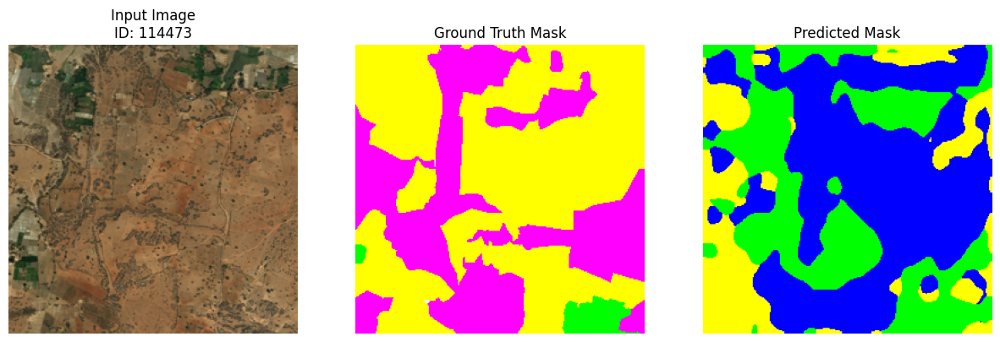

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


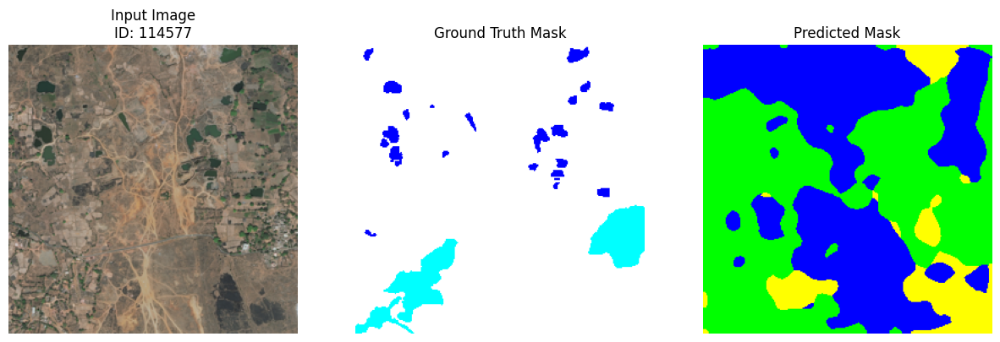

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


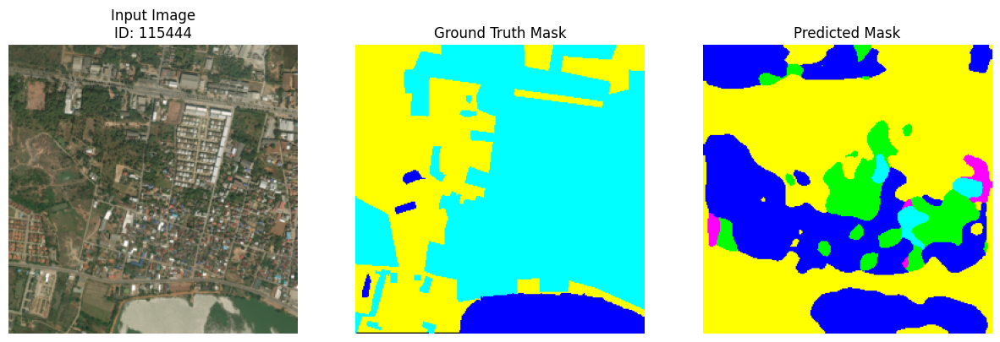

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


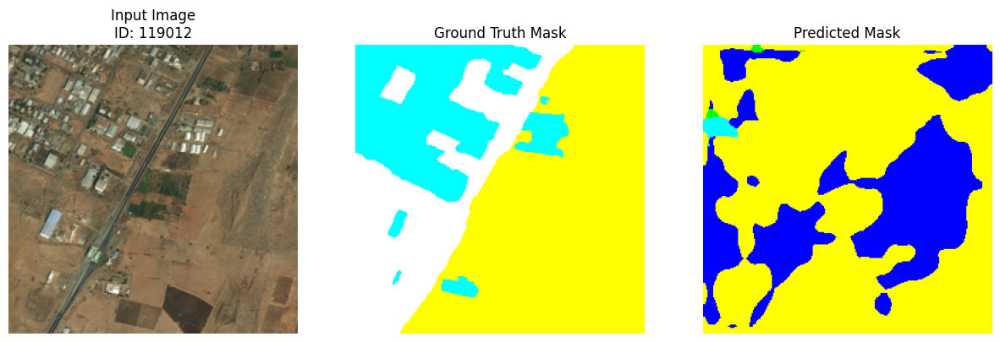

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


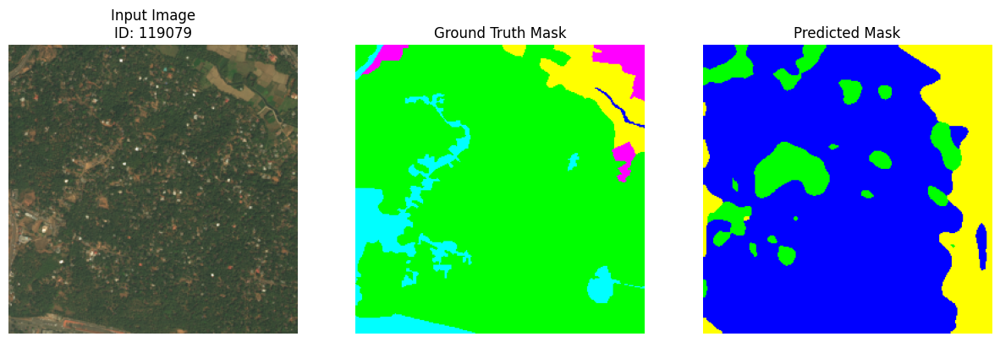

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


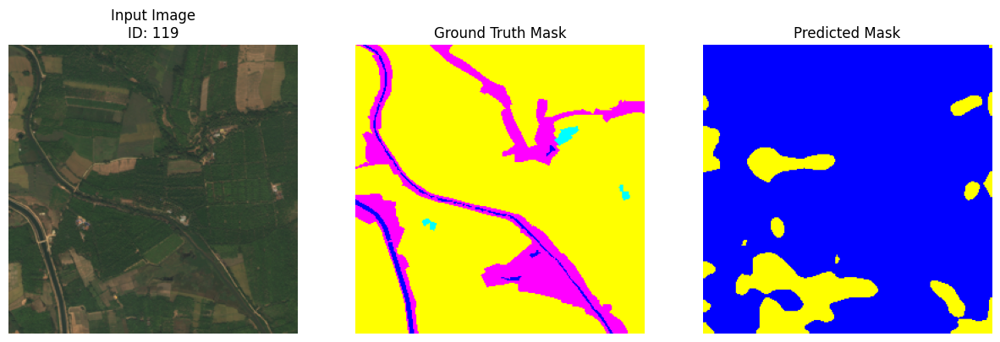

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


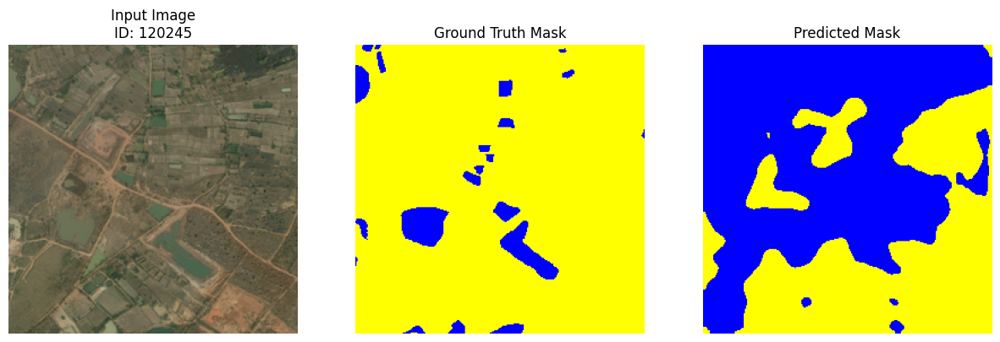

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


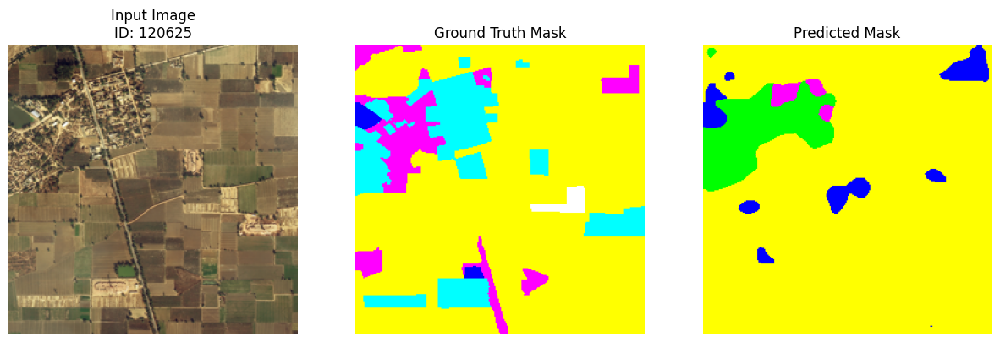

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


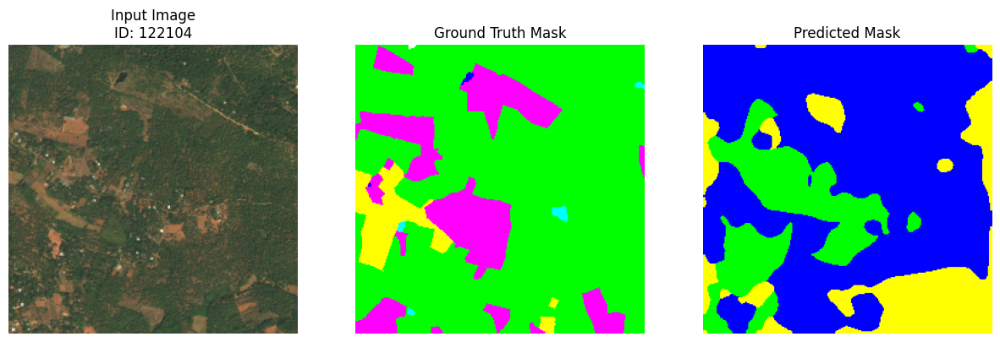

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


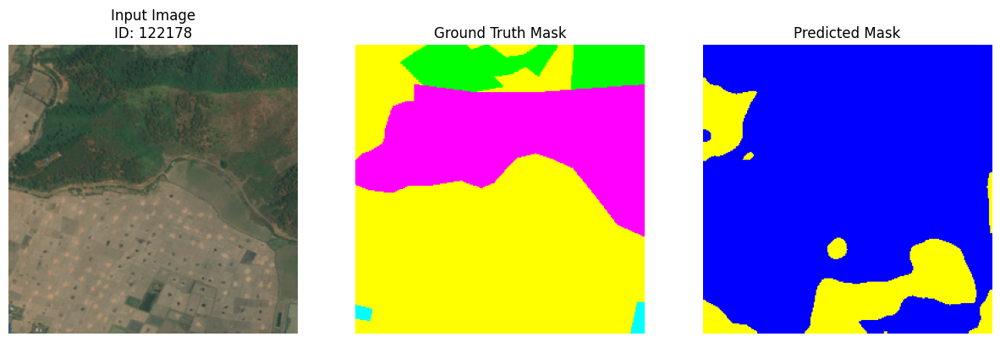

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


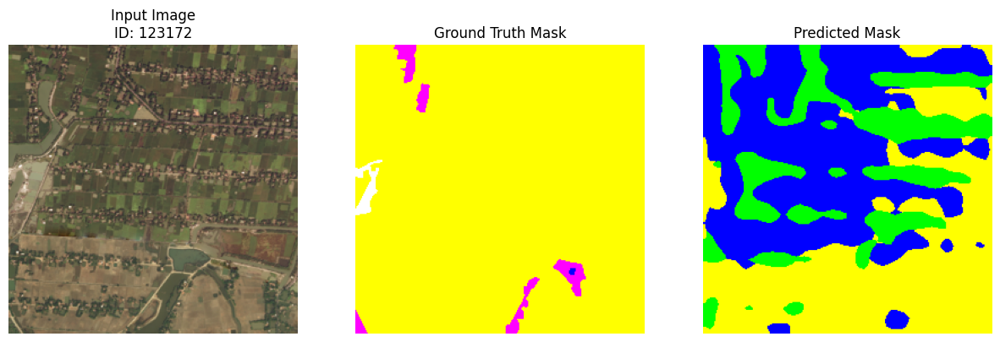

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


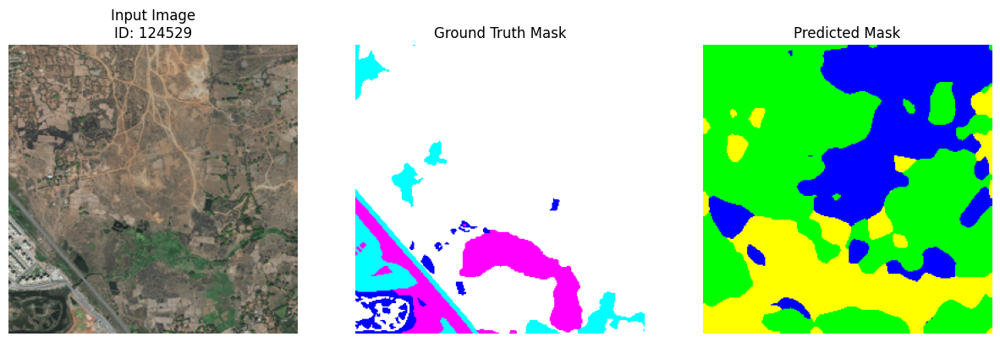

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


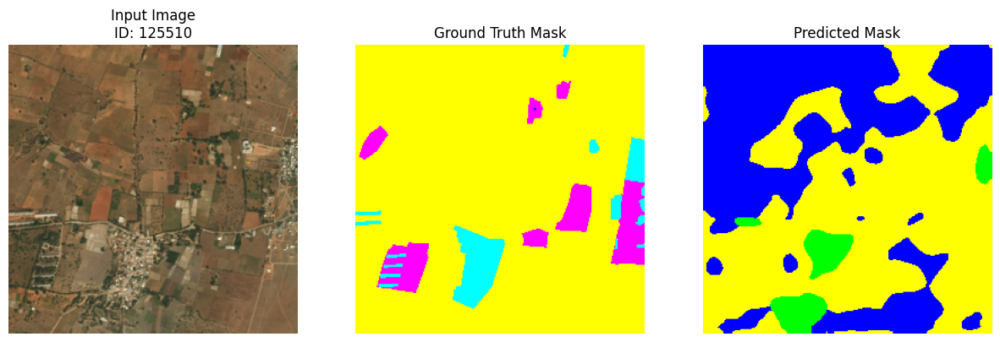

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


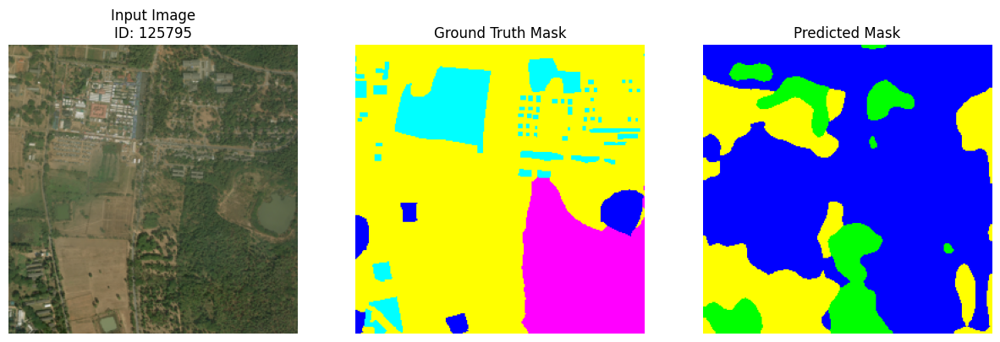

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


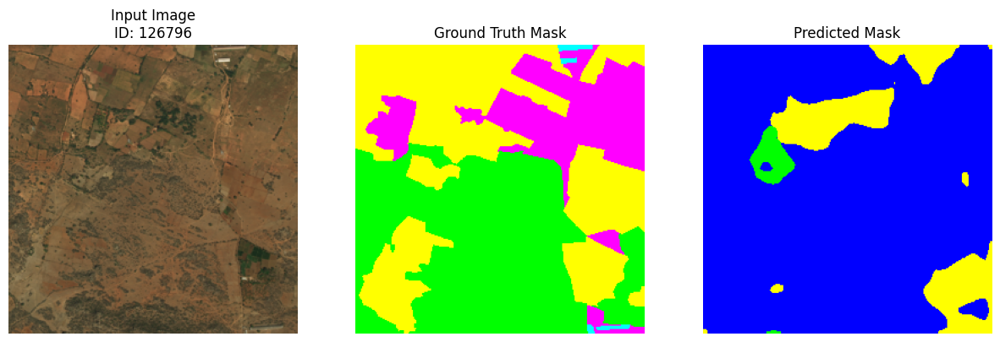

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


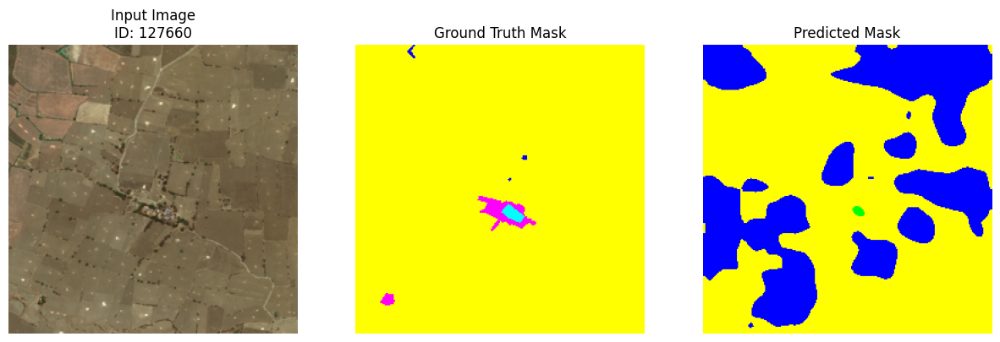

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


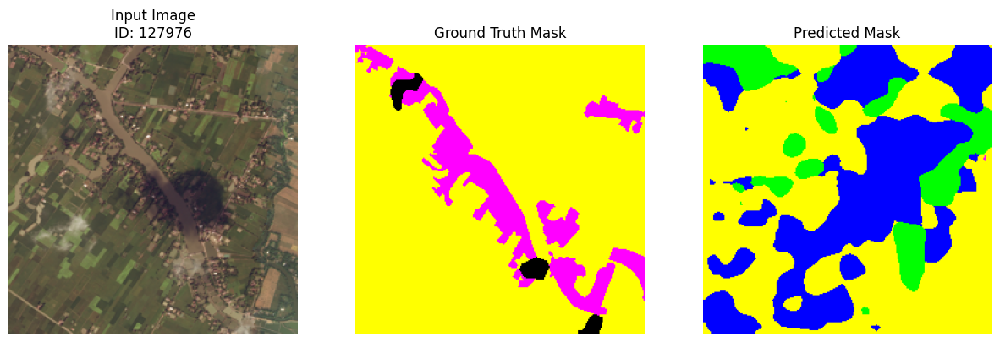

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


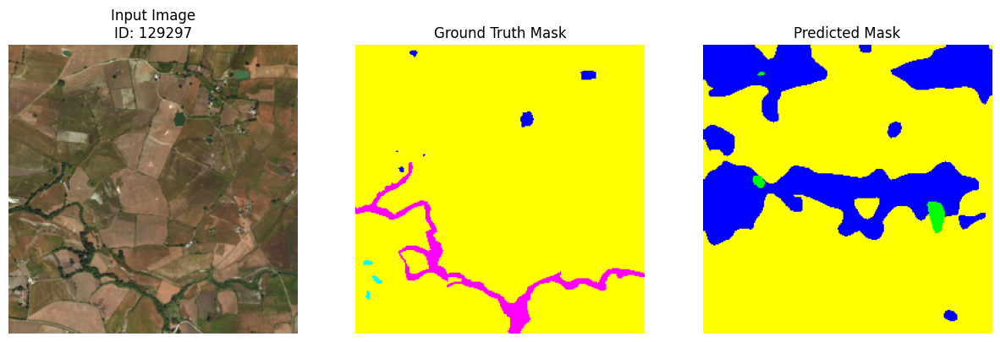

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


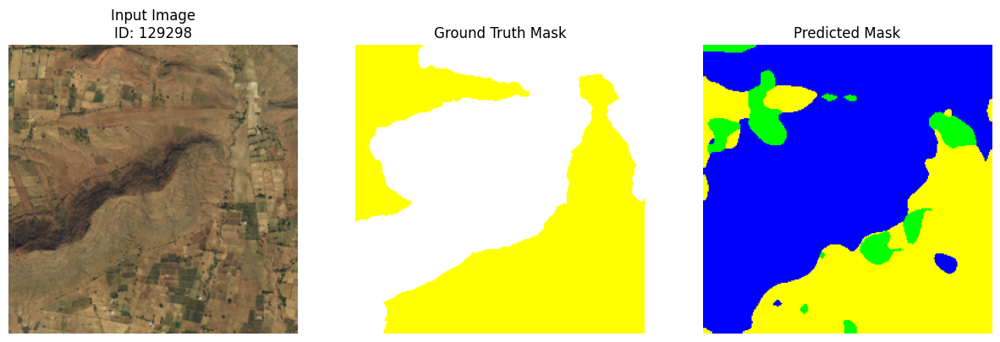

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


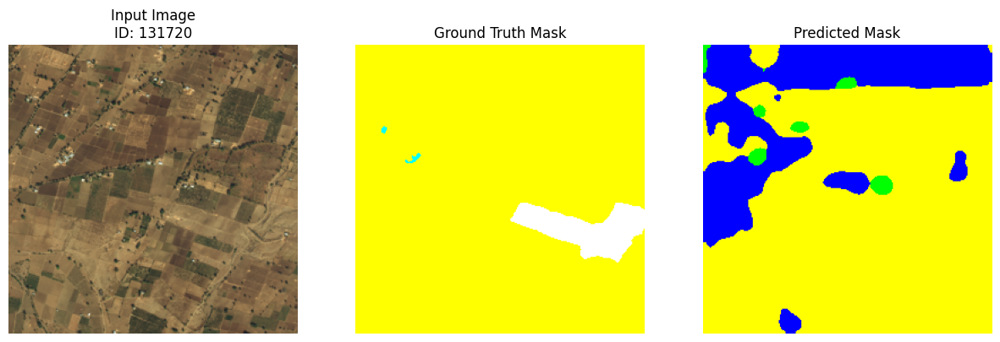

In [ ]:
start_idx = 10  # Start from the first image

visualize_predictions_ordered(model6, X, y, image_ids, start_idx=start_idx, num_images=20)

### model7

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import NASNetLarge
from tensorflow.keras import layers, Model
from tensorflow.keras.layers import Dense, Dropout, Conv2D, Input, UpSampling2D, GlobalAveragePooling2D

def NASNetLarge_UNet(input_shape=(256, 256, 3), num_classes=7):

    # Load NASNetLarge as the encoder
    base_model = NASNetLarge(weights="imagenet", include_top=False, input_shape=input_shape)

    x = base_model.output
    x = UpSampling2D(size=(2, 2))(x)  # Upsample
    x = Conv2D(128, kernel_size=(3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D(size=(2, 2))(x)  # Upsample
    x = Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D(size=(2, 2))(x)  # Upsample
    x = Conv2D(32, kernel_size=(3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D(size=(2, 2))(x)  # Upsample
    x = Conv2D(16, kernel_size=(3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D(size=(2, 2))(x)  # Upsample
    x = Conv2D(8, kernel_size=(3, 3), activation='relu', padding='same')(x)
    x = Conv2D(num_classes, kernel_size=(1, 1), activation='softmax', padding='same')(x)

    model = Model(inputs=base_model.input, outputs=x)
    return model, base_model


input_shape = (256, 256, 3)
num_classes = 7
model7, base_model7 = NASNetLarge_UNet(input_shape=input_shape, num_classes=num_classes)

model7.summary()


Model: "functional_49"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_68            │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_conv1 (Conv2D)       │ (None, 127, 127, 96)   │          2,592 │ input_layer_68[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_bn1                  │ (None, 127, 127, 96)   │            384 │ stem_conv1[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4940           │ (None, 127, 127, 96)   │              0 │ stem_bn1[0][0]         │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reduction_conv_1_stem_1   │ (None, 127, 127, 42)   │          4,032 │ activation_4940[0][0]  │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reduction_bn_1_stem_1     │ (None, 127, 127, 42)   │            168 │ reduction_conv_1_stem… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4941           │ (None, 127, 127, 42)   │              0 │ reduction_bn_1_stem_1… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4943           │ (None, 127, 127, 96)   │              0 │ stem_bn1[0][0]         │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ separable_conv_1_pad_red… │ (None, 131, 131, 42)   │              0 │ activation_4941[0][0]  │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ separable_conv_1_pad_red… │ (None, 133, 133, 96)   │              0 │ activation_4943[0][0]  │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ separable_conv_1_reducti… │ (None, 64, 64, 42)     │          2,814 │ separable_conv_1_pad_… │
│ (SeparableConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ separable_conv_1_reducti… │ (None, 64, 64, 42)     │          8,736 │ separable_conv_1_pad_… │
│ (SeparableConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ separable_conv_1_bn_redu… │ (None, 64, 64, 42)     │            168 │ separable_conv_1_redu… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ separable_conv_1_bn_r

 Total params: 89,659,913 (342.03 MB)

 Trainable params: 89,463,245 (341.28 MB)

 Non-trainable params: 196,668 (768.23 KB)

In [ ]:
for layer in base_model7.layers:
    layer.trainable = False

model7.compile(
    optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy", Custom_f1_score ,Custom_kappa_coefficient]
)

history7_1 = model7.fit(train_dataset, validation_data=val_dataset, epochs=20)

Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 91s 1s/step - accuracy: 0.3330 - custom_f1_score: 0.1134 - custom_kappa_coefficient: 0.0691 - loss: 1.7874 - val_accuracy: 0.5732 - val_custom_f1_score: 0.1579 - val_custom_kappa_coefficient: 0.1491 - val_loss: 1.4646
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 121ms/step - accuracy: 0.5772 - custom_f1_score: 0.2067 - custom_kappa_coefficient: 0.2502 - loss: 1.3917 - val_accuracy: 0.5624 - val_custom_f1_score: 0.2544 - val_custom_kappa_coefficient: 0.2771 - val_loss: 1.2816
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 122ms/step - accuracy: 0.6552 - custom_f1_score: 0.3311 - custom_kappa_coefficient: 0.4103 - loss: 1.1495 - val_accuracy: 0.6617 - val_custom_f1_score: 0.2494 - val_custom_kappa_coefficient: 0.3196 - val_loss: 1.1280
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 5s 123ms/step - accuracy: 0.7239 - custom_f1_score: 0.3744 - custom_kappa_coefficient: 0.4968 - loss: 0.9543 - val_accuracy: 0.6712 - val_custom_f1_score: 0.2884 - val_custom_kappa_coefficie

In [ ]:
for layer in base_model7.layers:
    layer.trainable = True

model7.compile(
    optimizer=tf.keras.optimizers.Nadam(learning_rate=1e-5),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy", Custom_f1_score ,Custom_kappa_coefficient]
)

history7_2 = model7.fit(train_dataset, validation_data=val_dataset, epochs=25)

Epoch 1/25
41/41 ━━━━━━━━━━━━━━━━━━━━ 482s 4s/step - accuracy: 0.4642 - custom_f1_score: 0.2412 - custom_kappa_coefficient: 0.1905 - loss: 2.7509 - val_accuracy: 0.6506 - val_custom_f1_score: 0.2773 - val_custom_kappa_coefficient: 0.2966 - val_loss: 1.2054
Epoch 2/25
41/41 ━━━━━━━━━━━━━━━━━━━━ 16s 379ms/step - accuracy: 0.5752 - custom_f1_score: 0.2552 - custom_kappa_coefficient: 0.2281 - loss: 1.4322 - val_accuracy: 0.6543 - val_custom_f1_score: 0.2569 - val_custom_kappa_coefficient: 0.2735 - val_loss: 1.1427
Epoch 3/25
41/41 ━━━━━━━━━━━━━━━━━━━━ 15s 376ms/step - accuracy: 0.6188 - custom_f1_score: 0.2941 - custom_kappa_coefficient: 0.3066 - loss: 1.2246 - val_accuracy: 0.6612 - val_custom_f1_score: 0.2595 - val_custom_kappa_coefficient: 0.2754 - val_loss: 1.1426
Epoch 4/25
41/41 ━━━━━━━━━━━━━━━━━━━━ 15s 374ms/step - accuracy: 0.6514 - custom_f1_score: 0.3170 - custom_kappa_coefficient: 0.3500 - loss: 1.0879 - val_accuracy: 0.6679 - val_custom_f1_score: 0.2618 - val_custom_kappa_coeff

## Predict Charlottesville

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


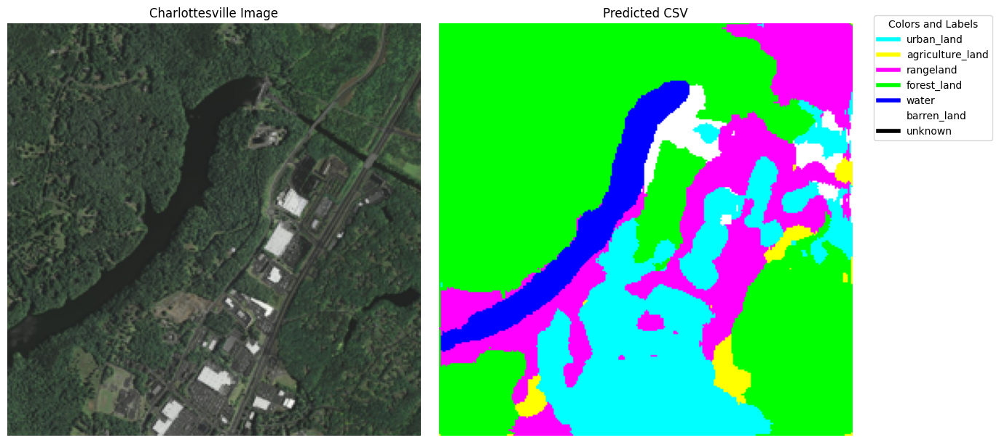

In [ ]:
csv_image = Image.open('part_of_charlottesville.jpg').convert('RGB').resize((256, 256))
norm_csv_image = np.array(csv_image) / 255.0
predict_csv=model3.predict(np.expand_dims(norm_csv_image, axis=0))
predict_csv= tf.argmax(predict_csv, axis=-1).numpy()[0]
predict_csv = decode_mask(predict_csv, color_map_inverted)

fig, axs = plt.subplots(1, 2, figsize=(12, 6))

axs[0].imshow(norm_csv_image)
axs[0].set_title(f"Charlottesville Image")
axs[0].axis("off")

# Ground Truth Mask
axs[1].imshow(predict_csv)
axs[1].set_title("Predicted CSV")
axs[1].axis("off")

legend_handles = []
for color, label in color_to_label.items():
    legend_handles.append(
        plt.Line2D(
            [0], [0],
            color=np.array(color) / 255.0,
            lw=4,
            label=label
        )
    )
fig.legend(
    handles=legend_handles,
    loc="upper right",
    title="Colors and Labels",
    bbox_to_anchor=(1.15, 1)
)

csv_save_path = os.path.join(".", f"csv_result.jpg")
plt.savefig(csv_save_path, bbox_inches="tight", dpi=300)
plt.tight_layout()
plt.show()

In [ ]:
model3_load = load_model("model3_8013.keras")

Model successfully loaded from ./saved_model/model3_8013.keras


In [ ]:
model3_tune_load = load_model("model3_7884_tune1.keras")

Model successfully loaded from ./saved_model/model3_7884_tune1.keras


In [ ]:
model5_load=load_model("model5_7568.keras")

Model successfully loaded from ./saved_model/model5_7568.keras


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


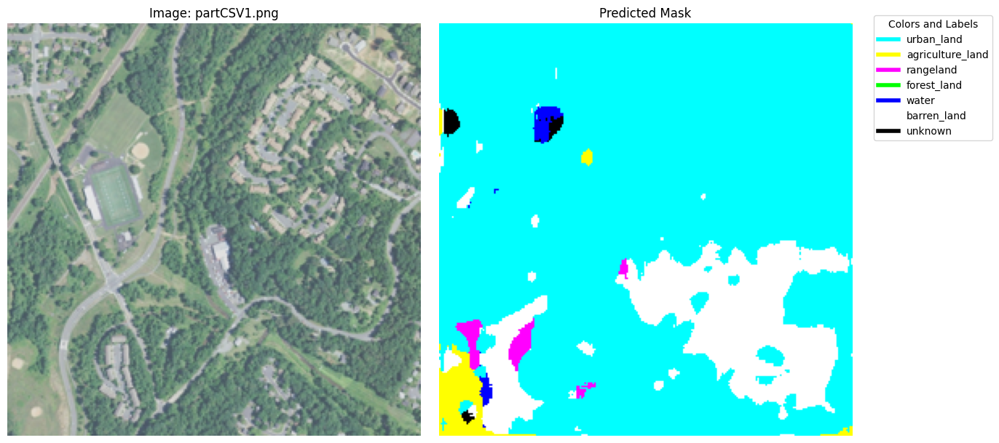

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


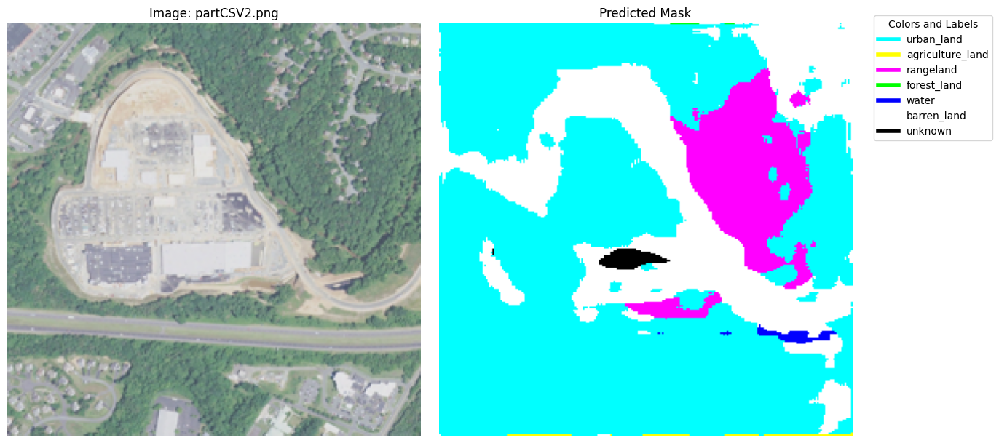

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


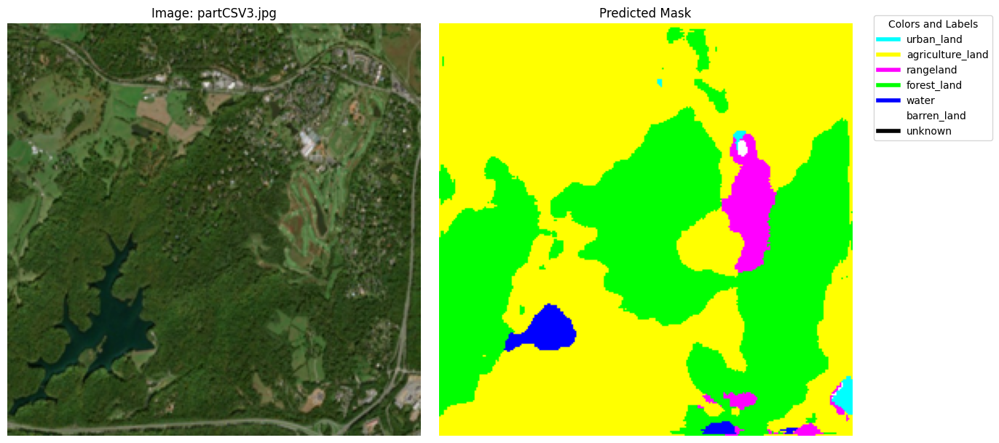

In [ ]:
from PIL import Image
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os

image_list = ['partCSV1.png', 'partCSV2.png', 'partCSV3.jpg']

for img_path in image_list:
    # Load and preprocess the image
    csv_image = Image.open(img_path).convert('RGB').resize((256, 256))
    norm_csv_image = np.array(csv_image) / 255.0

    # Predict the mask
    predict_csv = model3_load.predict(np.expand_dims(norm_csv_image, axis=0))
    predict_csv = tf.argmax(predict_csv, axis=-1).numpy()[0]
    predict_csv = decode_mask(predict_csv, color_map_inverted)

    # Create a figure for visualization
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    # Display the original image
    axs[0].imshow(norm_csv_image)
    axs[0].set_title(f"Image: {os.path.basename(img_path)}")
    axs[0].axis("off")

    # Display the predicted mask
    axs[1].imshow(predict_csv)
    axs[1].set_title("Predicted Mask")
    axs[1].axis("off")

    # Add legend
    legend_handles = []
    for color, label in color_to_label.items():
        legend_handles.append(
            plt.Line2D(
                [0], [0],
                color=np.array(color) / 255.0,
                lw=4,
                label=label
            )
        )
    fig.legend(
        handles=legend_handles,
        loc="upper right",
        title="Colors and Labels",
        bbox_to_anchor=(1.15, 1)
    )

    # Save the result for each image
    csv_save_path = os.path.join(".", f"{os.path.splitext(os.path.basename(img_path))[0]}_result.jpg")
    # plt.savefig(csv_save_path, bbox_inches="tight", dpi=300)
    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


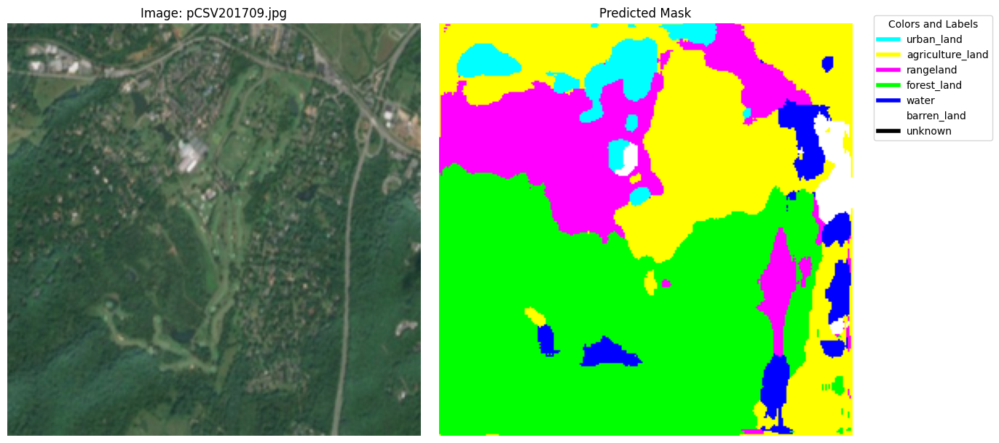

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


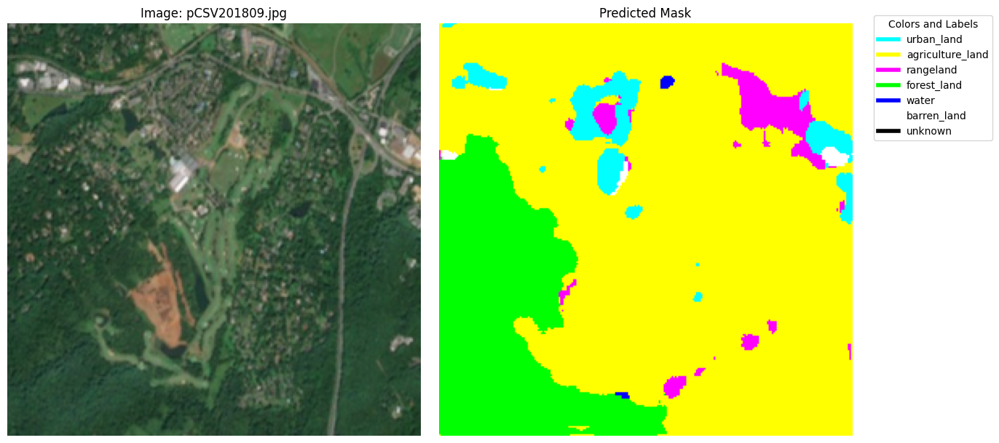

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


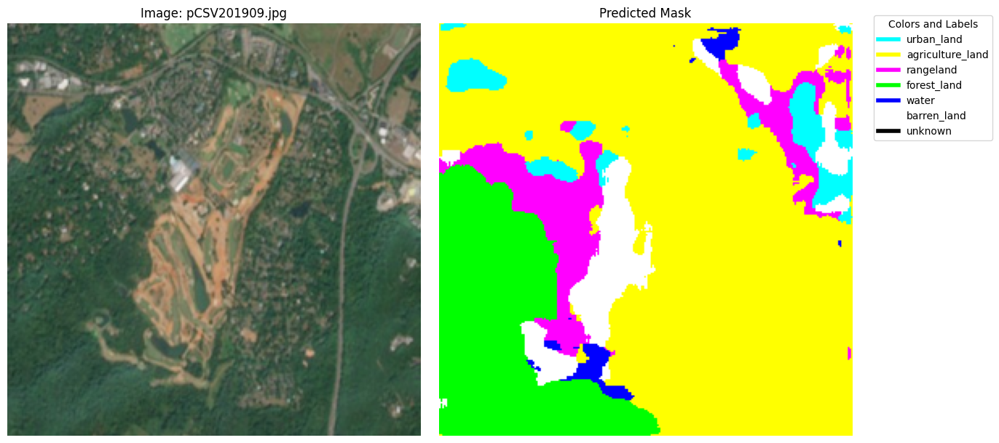

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


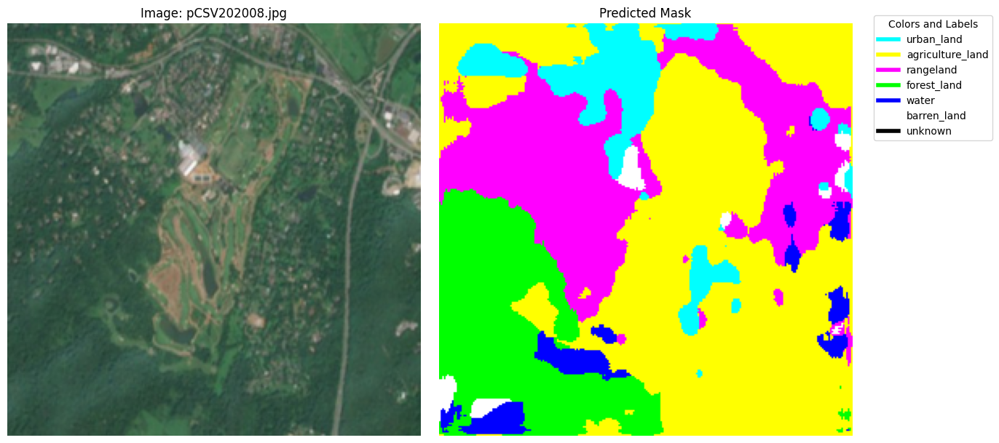

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


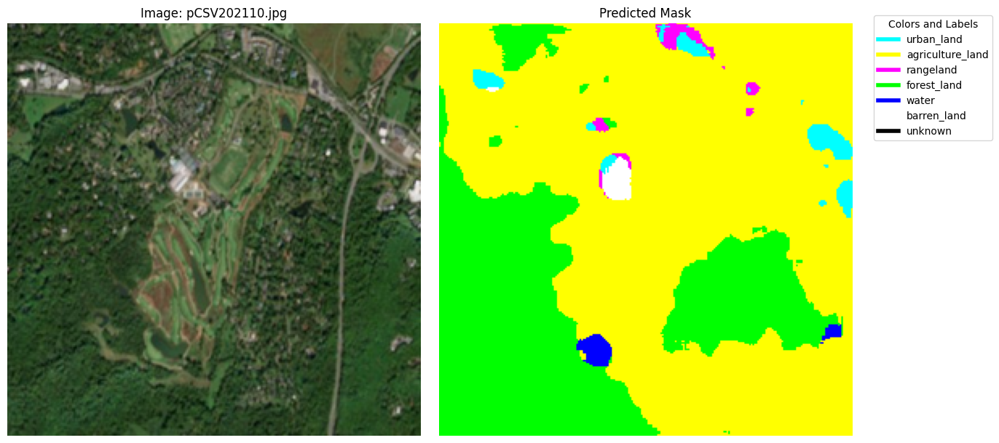

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


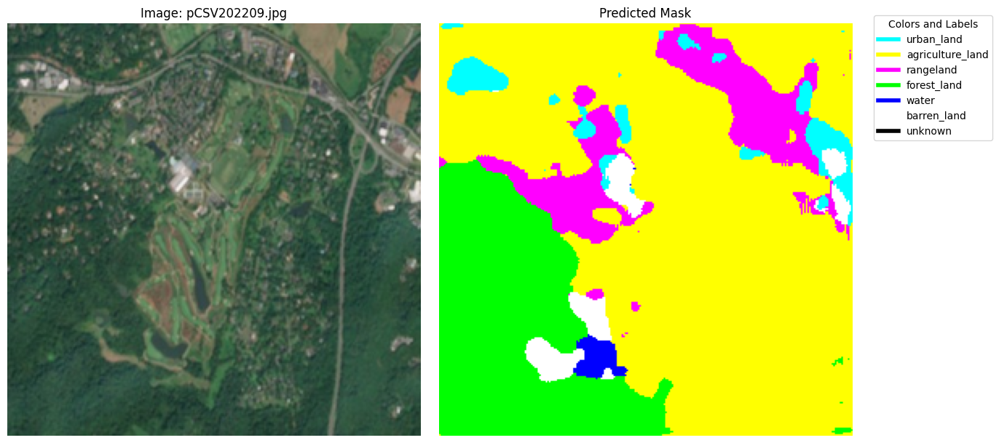

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


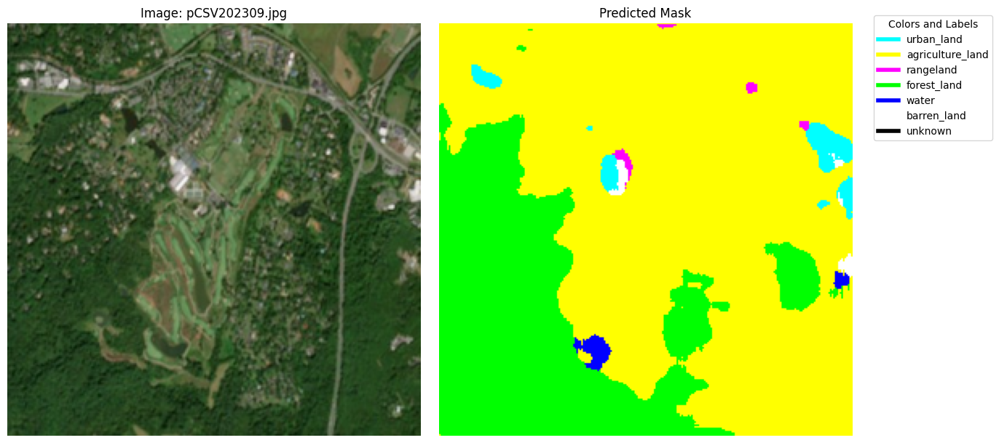

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


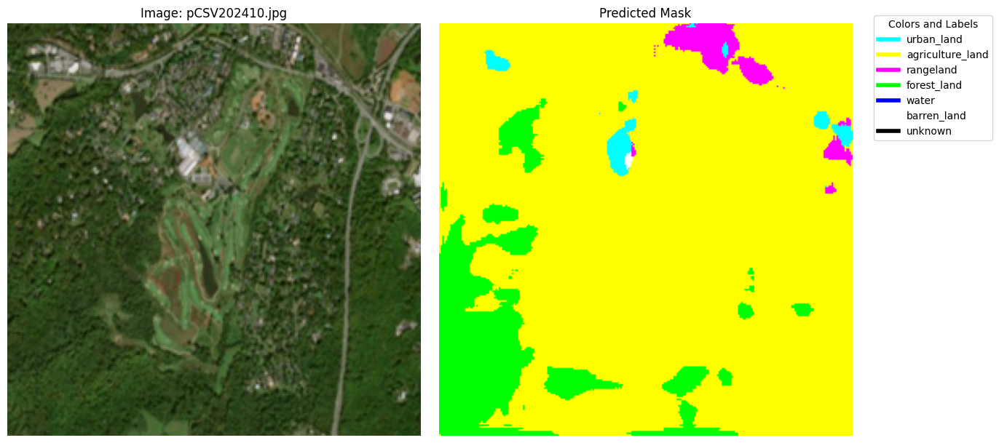

In [ ]:
from PIL import Image
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os

image_list = ['pCSV201709.jpg','pCSV201809.jpg','pCSV201909.jpg', 'pCSV202008.jpg', 'pCSV202110.jpg', 'pCSV202209.jpg', 'pCSV202309.jpg', 'pCSV202410.jpg']


for img_path in image_list:
    # Load and preprocess the image
    csv_image = Image.open(img_path).convert('RGB').resize((256, 256))
    norm_csv_image = np.array(csv_image) / 255.0

    # Predict the mask
    predict_csv = model3_load.predict(np.expand_dims(norm_csv_image, axis=0))
    predict_csv = tf.argmax(predict_csv, axis=-1).numpy()[0]
    predict_csv = decode_mask(predict_csv, color_map_inverted)

    # Create a figure for visualization
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    axs[0].imshow(norm_csv_image)
    axs[0].set_title(f"Image: {os.path.basename(img_path)}")
    axs[0].axis("off")

    axs[1].imshow(predict_csv)
    axs[1].set_title("Predicted Mask")
    axs[1].axis("off")

    # Add legend
    legend_handles = []
    for color, label in color_to_label.items():
        legend_handles.append(
            plt.Line2D(
                [0], [0],
                color=np.array(color) / 255.0,
                lw=4,
                label=label
            )
        )
    fig.legend(
        handles=legend_handles,
        loc="upper right",
        title="Colors and Labels",
        bbox_to_anchor=(1.15, 1)
    )

    # Save the result for each image
    csv_save_path = os.path.join(".", f"{os.path.splitext(os.path.basename(img_path))[0]}_result.jpg")
    # plt.savefig(csv_save_path, bbox_inches="tight", dpi=300)
    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step


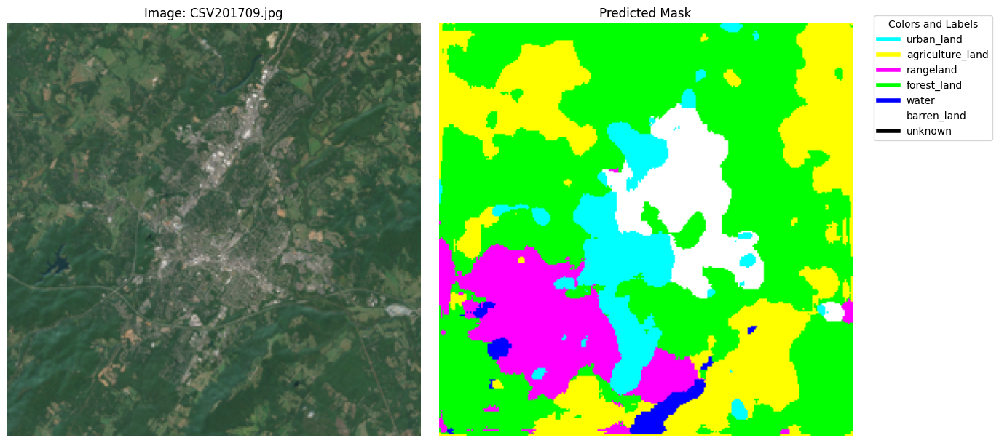

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


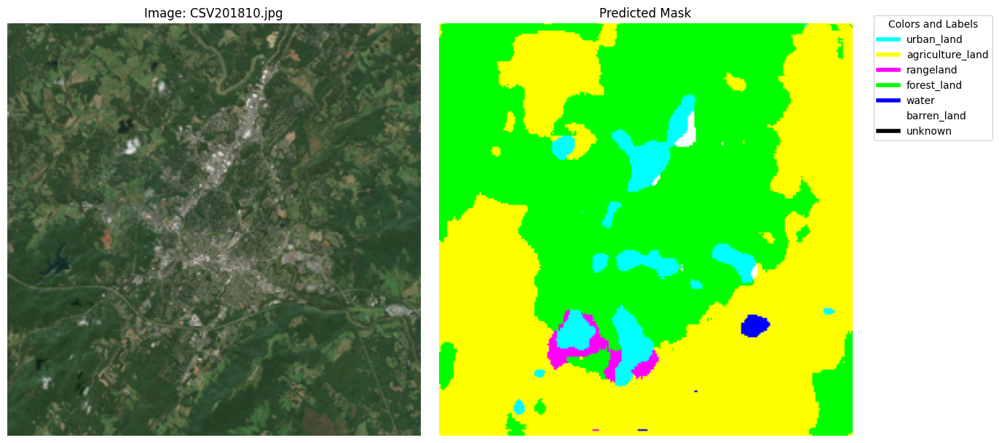

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


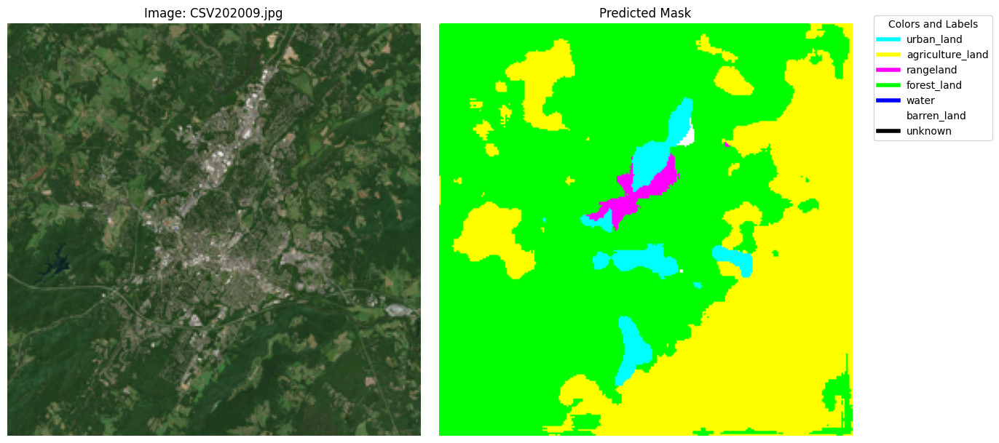

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


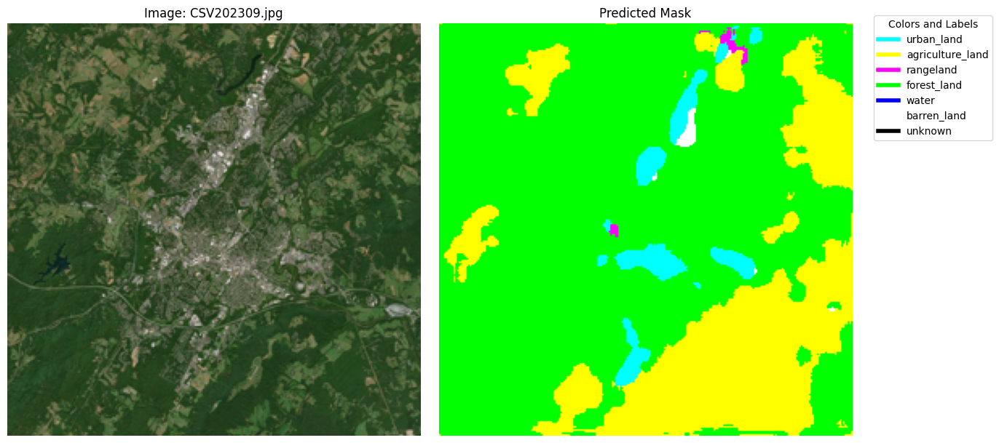

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


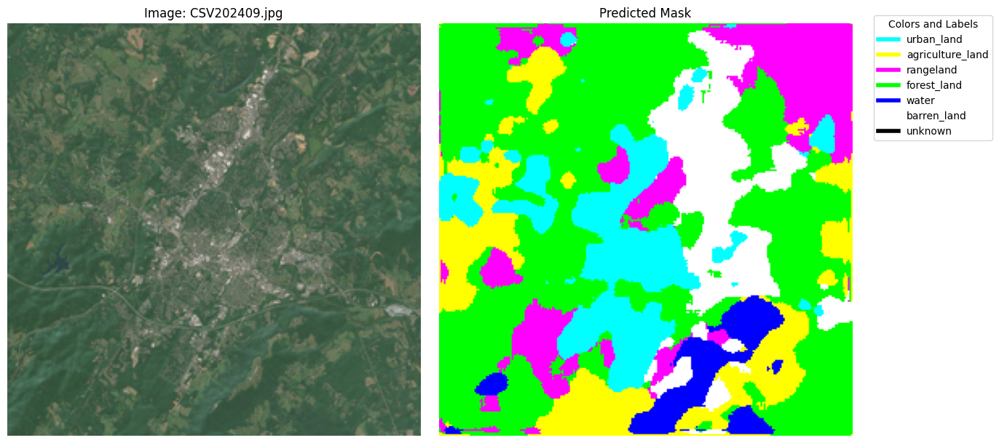

In [ ]:
from PIL import Image
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os

# Define your decode_mask and color_to_label as per your project
# Assuming color_map_inverted and decode_mask are already defined

# Example list of image paths
image_list = ['CSV201709.jpg', 'CSV201810.jpg', 'CSV202009.jpg', 'CSV202309.jpg', 'CSV202409.jpg']

# Loop through each image
for img_path in image_list:
    # Load and preprocess the image
    csv_image = Image.open(img_path).convert('RGB').resize((256, 256))
    norm_csv_image = np.array(csv_image) / 255.0

    # Predict the mask
    predict_csv = model3_load.predict(np.expand_dims(norm_csv_image, axis=0))
    predict_csv = tf.argmax(predict_csv, axis=-1).numpy()[0]
    predict_csv = decode_mask(predict_csv, color_map_inverted)

    # Create a figure for visualization
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    # Display the original image
    axs[0].imshow(norm_csv_image)
    axs[0].set_title(f"Image: {os.path.basename(img_path)}")
    axs[0].axis("off")

    # Display the predicted mask
    axs[1].imshow(predict_csv)
    axs[1].set_title("Predicted Mask")
    axs[1].axis("off")

    # Add legend
    legend_handles = []
    for color, label in color_to_label.items():
        legend_handles.append(
            plt.Line2D(
                [0], [0],
                color=np.array(color) / 255.0,
                lw=4,
                label=label
            )
        )
    fig.legend(
        handles=legend_handles,
        loc="upper right",
        title="Colors and Labels",
        bbox_to_anchor=(1.15, 1)
    )

    # Save the result for each image
    csv_save_path = os.path.join(".", f"{os.path.splitext(os.path.basename(img_path))[0]}_result.jpg")
    # plt.savefig(csv_save_path, bbox_inches="tight", dpi=300)
    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


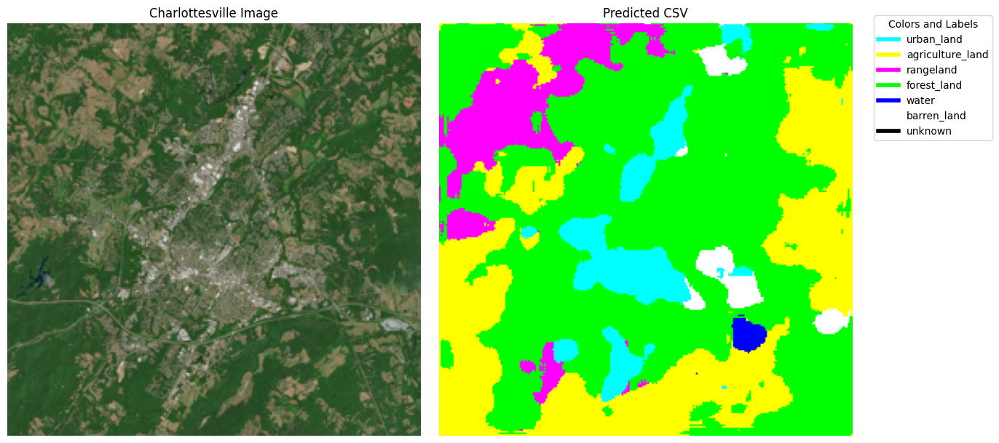

In [ ]:
csv_image = Image.open('charlottesville.jpg').convert('RGB').resize((256,256))
norm_csv_image = np.array(csv_image) / 255.0
predict_csv=model3_load.predict(np.expand_dims(norm_csv_image, axis=0))
predict_csv= tf.argmax(predict_csv, axis=-1).numpy()[0]
predict_csv = decode_mask(predict_csv, color_map_inverted)

fig, axs = plt.subplots(1, 2, figsize=(12, 6))

axs[0].imshow(norm_csv_image)
axs[0].set_title(f"Charlottesville Image")
axs[0].axis("off")

# Ground Truth Mask
axs[1].imshow(predict_csv)
axs[1].set_title("Predicted CSV")
axs[1].axis("off")

legend_handles = []
for color, label in color_to_label.items():
    legend_handles.append(
        plt.Line2D(
            [0], [0],
            color=np.array(color) / 255.0,
            lw=4,
            label=label
        )
    )
fig.legend(
    handles=legend_handles,
    loc="upper right",
    title="Colors and Labels",
    bbox_to_anchor=(1.15, 1)
)

csv_save_path = os.path.join(".", f"csv_result.jpg")
plt.savefig(csv_save_path, bbox_inches="tight", dpi=300)
plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


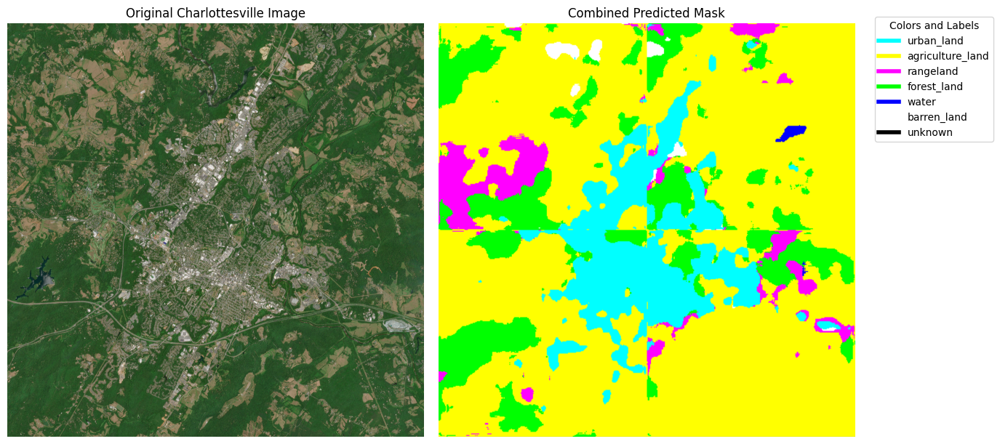

In [ ]:
from PIL import Image
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os

# Load the large image
image_path = 'charlottesville.jpg'
large_image = Image.open(image_path).convert('RGB')
original_width, original_height = large_image.size

# Divide the image into 4 parts
def divide_image_into_quarters(image):
    width, height = image.size
    quarters = [
        image.crop((0, 0, width // 2, height // 2)),           # Top-left
        image.crop((width // 2, 0, width, height // 2)),      # Top-right
        image.crop((0, height // 2, width // 2, height)),     # Bottom-left
        image.crop((width // 2, height // 2, width, height))  # Bottom-right
    ]
    return quarters

quarters = divide_image_into_quarters(large_image)

# Resize each quarter to 256x256
resized_quarters = [q.resize((256, 256)) for q in quarters]

# Normalize and predict each resized quarter
predicted_quarters = []
for quarter in resized_quarters:
    normalized_quarter = np.array(quarter) / 255.0
    input_quarter = np.expand_dims(normalized_quarter, axis=0)  # Add batch dimension
    prediction = model3_load.predict(input_quarter)
    decoded_prediction = tf.argmax(prediction, axis=-1).numpy()[0]
    predicted_mask = decode_mask(decoded_prediction, color_map_inverted)
    predicted_quarters.append(predicted_mask)

# Combine the predictions back into one image
def combine_quarters(predicted_quarters, output_size):
    combined_image = Image.new("RGB", output_size)

    # Resize predictions back to their original quarter size
    resized_predictions = [Image.fromarray(p).resize((output_size[0] // 2, output_size[1] // 2))
                           for p in predicted_quarters]

    # Paste each quarter into the combined image
    combined_image.paste(resized_predictions[0], (0, 0))  # Top-left
    combined_image.paste(resized_predictions[1], (output_size[0] // 2, 0))  # Top-right
    combined_image.paste(resized_predictions[2], (0, output_size[1] // 2))  # Bottom-left
    combined_image.paste(resized_predictions[3], (output_size[0] // 2, output_size[1] // 2))  # Bottom-right

    return combined_image

final_predicted_image = combine_quarters(predicted_quarters, (original_width, original_height))

# Display the original and predicted images
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Original Image
axs[0].imshow(large_image)
axs[0].set_title(f"Original Charlottesville Image")
axs[0].axis("off")

# Predicted Mask
axs[1].imshow(final_predicted_image)
axs[1].set_title("Combined Predicted Mask")
axs[1].axis("off")

# Legend for categories
legend_handles = []
for color, label in color_to_label.items():
    legend_handles.append(
        plt.Line2D(
            [0], [0],
            color=np.array(color) / 255.0,
            lw=4,
            label=label
        )
    )
fig.legend(
    handles=legend_handles,
    loc="upper right",
    title="Colors and Labels",
    bbox_to_anchor=(1.15, 1)
)

# Save the final output
output_save_path = os.path.join(".", f"combined_csv_result.jpg")
plt.savefig(output_save_path, bbox_inches="tight", dpi=300)
plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


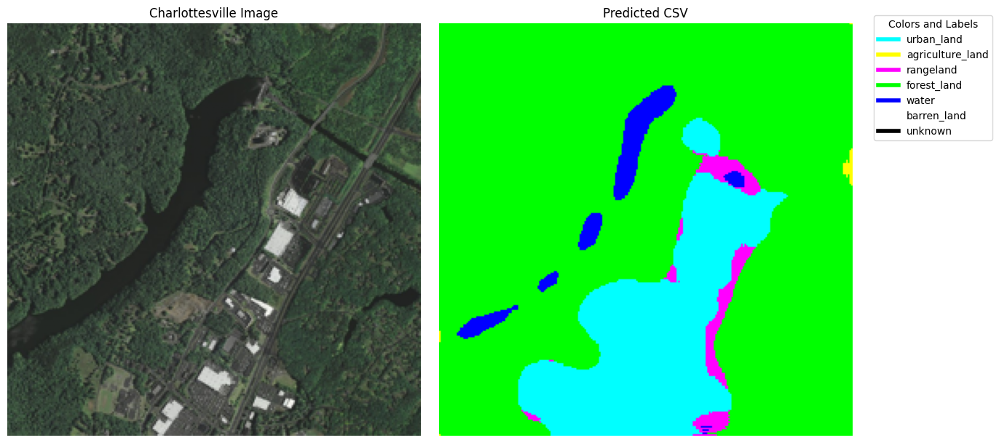

In [ ]:
csv_image = Image.open('part_of_charlottesville.jpg').convert('RGB').resize((256, 256))
norm_csv_image = np.array(csv_image) / 255.0
predict_csv=model5.predict(np.expand_dims(norm_csv_image, axis=0))
predict_csv= tf.argmax(predict_csv, axis=-1).numpy()[0]
predict_csv = decode_mask(predict_csv, color_map_inverted)

fig, axs = plt.subplots(1, 2, figsize=(12, 6))

axs[0].imshow(norm_csv_image)
axs[0].set_title(f"Charlottesville Image")
axs[0].axis("off")

axs[1].imshow(predict_csv)
axs[1].set_title("Predicted CSV")
axs[1].axis("off")

legend_handles = []
for color, label in color_to_label.items():
    legend_handles.append(
        plt.Line2D(
            [0], [0],
            color=np.array(color) / 255.0,
            lw=4,
            label=label
        )
    )
fig.legend(
    handles=legend_handles,
    loc="upper right",
    title="Colors and Labels",
    bbox_to_anchor=(1.15, 1)
)

csv_save_path = os.path.join(".", f"csv_result.jpg")
plt.savefig(csv_save_path, bbox_inches="tight", dpi=300)
plt.tight_layout()
plt.show()